In [1]:
%reload_ext autoreload
%autoreload 2

### Preconditions & imports

In [2]:
from preamble import *

### Metrics metadata

In [3]:
metric_metadata = {
    'Compartment area': {
        'short_name': 'CZ3A',
        'label': r'$a_{cz3}$',
        'label_normal': r'$(a_{cz3}-\min(a_{cz3}))/(\overline{a_{cz3}}-\min(a_{cz3}))$', 
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(a_{cz3})$',
        'rvs': [stats.gamma],
        'limits': (0, np.inf),
        'units': r'$\mu m^2$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Major axis angle': {
        'short_name': 'MOa',
        'label': r'$\theta_{\rm cz3}$',
        'label_normal': r'$(\theta_{\rm cz3}-\min(\theta_{\rm cz3}))/(\overline{\theta_{\rm cz3}}-\min(\theta_{\rm cz3}))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(\theta_{\rm cz3})$',
        'rvs': [stats.gamma],
        'limits': (0, 90),
        'units': r'degrees',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Compartment major axis': {
        'short_name': 'CZ3Ma',
        'label': r'$d_{\text{maj}}$',
        'label_normal': r'$(d_{\text{maj}}-\min(d_{\text{maj}}))/(\overline{d_{\text{maj}}}-\min(d_{\text{maj}}))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(d_{\text{maj}})$',
        'rvs': [stats.gamma],
        'limits': (0, np.inf),
        'units': r'$\mu m$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Compartment minor axis': {
        'short_name': 'CZ3Mi',
        'label': r'$d_{\text{min}}$',
        'label_normal': r'$(d_{\text{min}}-\min(d_{\text{min}}))/(\overline{d_{\text{min}}}-\min(d_{\text{min}}))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(d_{\text{min}})$',
        'rvs': [stats.gamma],
        'limits': (0, np.inf),
        'units': r'$\mu m$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Voronoi Area': {
        'short_name': 'VA',
        'label': r'$a_v$',
        'label_normal': r'$(a_v-\min(a_v))/(\overline{a_v}-\min(a_v))$', 
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(a_v)$',
        'rvs': [stats.gamma],
        'limits': (0, np.inf),
        'units': r'$\mu m^2$',
        'ap_pos_metric': 'Voronoi AP position',
        'floc': None,
    },
    'Compartment perimeter': {
        'short_name': 'CZ3P',
        'label': r'$p_{cz3}$',
        'label_normal': r'$(p_{cz3}-\min(p_{cz3}))/(\overline{p_{cz3}}-\min(p_{cz3}))$', 
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(p_{cz3})$',
        'rvs': [stats.gamma],
        'limits': (0, np.inf),
        'units': r'$\mu m$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Cell area': {
        'short_name': 'CA',
        'label': r'$a_{cell}$',
        'label_normal': r'$(a_{cell}-\min(a_{cell}))/(\overline{a_{cell}}-\min(a_{cell}))$',
        'corr_transform': lambda x: x,
        'corr_transform_label': r'$a_{cell}$',
        'rvs': [],
        'limits': (0, 80),
        'units': r'$\mu m^2$',
        'ap_pos_metric': 'Cell AP position',
        'floc': None,
    },
    'Cell diameter': {
        'short_name': 'CD',
        'label': r'$d_{cell}$',
        'label_normal': r'$(d_{cell}-\min(d_{cell}))/(\overline{d_{cell}}-\min(d_{cell}))$',
        'corr_transform': lambda x: x,
        'corr_transform_label': r'$d_{cell}$',
        'rvs': [],
        'limits': (0, np.inf),
        'units': r'$\mu m$',
        'ap_pos_metric': 'Cell AP position',
        'floc': None,
    },
    'Aspect ratio': {
        'short_name': 'AR',
        'label': r'$\alpha$',
        'label_normal': r'$(\alpha-\min(\alpha))/(\overline{\alpha}-\min(\alpha))$',
        'corr_transform': lambda x: np.log10(x-1),
        'corr_transform_label': r'$\log_{10}(\alpha-1)$',
        'rvs': [stats.gamma],
        'limits': (0, 2),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': 1.
    },
    'Cell aspect ratio': {
        'short_name': 'CAR',
        'label': r'$\alpha_{\rm cell}$',
        'label_normal': r'$(\alpha_{\rm cell}-\min(\alpha_{\rm cell}))/(\overline{\alpha_{\rm cell}}-\min(\alpha_{\rm cell}))$',
        'corr_transform': lambda x: np.log10(x-1),
        'corr_transform_label': r'$\log_{10}(\alpha_{\rm cell}-1)$',
    },
    'Isoperimetric deficit': {
        'short_name': 'ID',
        'label': r'$\delta$',
        'label_normal': r'$(\delta-\min(\delta))/(\overline{\delta}-\min(\delta))$',
        'corr_transform': lambda x: np.log10(x - PlanarPolygon.id_ngon(6)),
        'corr_transform_label': r'$\log_{10}(\delta - \delta_6)$',
        'rvs': [],
        'limits': (0, 0.35),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Circularity': {
        'short_name': 'Circ',
        'label': r'$q$',
        'label_normal': r'$(q-\min(q))/(\overline{q}-\min(q))$',
        'corr_transform': lambda x: x / PlanarPolygon.ir_ngon(6),
        'corr_transform_label': r'$q / q_{\text{hex}}$',
        'rvs': [],
        'limits': (0, 1),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'ID (whitened)': {
        'short_name': 'ID (W)',
        'label': r'$\tilde{\delta}$',
        'label_normal': r'$(\tilde{\delta}-\min(\tilde{\delta}))/(\overline{\tilde{\delta}}-\min(\tilde{\delta}))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(\tilde{\delta})$',
        'rvs': [],
        'limits': (0, np.inf),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Circularity (whitened)': {
        'short_name': 'Circ (W)',
        'label': r'$\tilde{q}$',
        'label_normal': r'$(\tilde{q}-\min(\tilde{q}))/(\overline{\tilde{q}}-\min(\tilde{q}))$',
        'corr_transform': lambda x: x / PlanarPolygon.ir_ngon(6),
        'corr_transform_label': r'$\tilde{q} / q_{\text{hex}}$',
        'rvs': [],
        'limits': (0, 1),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Offset': {
        'short_name': 'O',
        'label': r'$r$',
        'label_normal': r'$(r-\min(r))/(\overline{r}-\min(r))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(r)$',
        'rvs': [stats.gamma],
        'limits': (0, 10),
        'units': r'$\mu m$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Offset angle': {
        'short_name': 'Oa',
        'label': r'$\theta_{\rm cell}$',
        'label_normal': r'$(\theta_{\rm cell}-\min(\theta_{\rm cell}))/(\overline{\theta_{\rm cell}}-\min(\theta_{\rm cell}))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(\theta_{\rm cell})$',
        'rvs': [stats.gamma],
        'limits': (0, 90),
        'units': r'degrees',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Squared offset': {
        'short_name': 'O',
        'label': r'$r^2$',
        'label_normal': r'$(r^2-\min(r^2))/(\overline{r^2}-\min(r^2))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(r^2)$',
        'rvs': [stats.gamma],
        'limits': (0, 10),
        'units': r'$\mu m^2$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Offset (whitened)': {
        'short_name': 'O (W)',
        'label': r'$\tilde{r}$',
        'label_normal': r'$(\tilde{r}-\min(\tilde{r}))/(\overline{\tilde{r}}-\min(\tilde{r}))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(\tilde{r})$',
        'rvs': [],
        'limits': (0, np.inf),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Circular radius': {
        'short_name': 'CR',
        'label': r'$R$',
        'label_normal': r'$(R-\min(R))/(\overline{R}-\min(R))$',
        'corr_transform': lambda x: x,
        'corr_transform_label': r'$R$',
        'rvs': [],
        'limits': (0, np.inf),
        'units': r'$\mu m$',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Sum of second moments': {
        'short_name': 'PIM',
        'label': r'$J$',
        'label_normal': r'$(J-\min(J))/(\overline{J}-\min(J))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(J)$',
        'rvs': [stats.gamma],
        'limits': (0.15, 0.3),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Voronoi error': {
        'short_name': 'VE',
        'label': r'$e_V$',
        'label_normal': r'$(e_V-\min(e_V))/(\overline{e_V}-\min(e_V))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label':r'$\log_{10}(e_V)$',
        'rvs': [],
        'limits': (0, np.inf),
        'units': 'unitless',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Voronoi neighbors': {
        'short_name': 'VN',
        'label': r'$n_V$',
        'label_normal': r'$(n_V-\min(n_V))/(\overline{n_V}-\min(n_V))$',
        'corr_transform': lambda x: np.log10(x),
        'corr_transform_label': r'$\log_{10}(n_V)$',
        'rvs': [],
        'limits': (0, np.inf),
        'units': 'count',
        'ap_pos_metric': 'Compartment AP position',
        'floc': None,
    },
    'Distance to center': {
        'short_name': 'DC',
        'label': r'$d_{\rm center}$',
        'label_normal': r'$(d_{\rm center}-\min(d_{\rm center}))/(\overline{d_{\rm center}}-\min(d_{\rm center}))$',
        'corr_transform': lambda x: x,
        'corr_transform_label': r'$d_{\rm center}$',
    },
    'Mahalanobis distance to center': {
        'short_name': 'MD',
        'label': r'$d_{\rm mah}$',
        'label_normal': r'$(d_{\rm mah}-\min(d_{\rm mah}))/(\overline{d_{\rm mah}}-\min(d_{\rm mah}))$',
        'corr_transform': lambda x: x,
        'corr_transform_label': r'$d_{\rm mah}$',
    },
    'Chull-projected normal': {
        'short_name': 'Chull-projected normal',
        'label': r'$\cos(\theta_z)$',
        'label_normal': r'$(\cos(\theta_z)-\min(\cos(\theta_z)))/(\overline{\cos(\theta_z)}-\min(\cos(\theta_z}))$',
        'corr_transform': lambda x: x,
        'corr_transform_label': r'$\cos(\theta_z)$',
    },
}

seg_metric_metadata = {
    'Spheroid radius': {
        'label': r'$r$ ($\mu$m)',
        'log': False,
    },
    'Spheroid major axis': {
        'label': r'$d_{\text{maj}}$ ($\mu$m)',
        'log': False,
    },
    'Spheroid minor axis': {
        'label': r'$d_{\text{min}}$ ($\mu$m)',
        'log': False,
    },
    'Spheroid aspect ratio': {
        'label': r'$\alpha$',
        'log': False,
    },
    r'$k_{\rm gamma}(\alpha)$': {
        'label': r'$k$',
        'log': False,
    },
    r'$p_{\rm ks} (k_{\rm gamma}(\alpha))$': {
        'label': r'$p$',
        'log': False,
    },
    r'$k_{\rm gamma}(a_{\rm cz3})$': {
        'label': r'$k$',
        'log': True,
    },
    r'$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$' : {
        'label': r'$p$',
        'log': False,  
    },
    r'$k_{\rm gamma}(a_{\rm cz3})$ (anterior)': {
        'label': r'$k$',
        'log': True,
    },
    r'$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$ (anterior)': {
        'label': r'$p$',
        'log': False,  
    },
    r'$k_{\rm gamma}(a_{\rm cz3})$ (posterior)': {
        'label': r'$k$',
        'log': True,
    },
    r'$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$ (posterior)': {
        'label': r'$p$',
        'log': False,
    },
    r'Sum of second moments': {
        'label': r'$J$',
        'log': False,
    },
    'Median Voronoi error': {
        'label': r'med($E_V$)',
        'log': False,
    },
}

''' Pairs on which to perform linear regression '''

cross_linear_regressions = {
    frozenset({'Compartment area', 'Cell area'}): {'I', 'II', 'III'},
    frozenset({'Compartment area', 'Aspect ratio'}): {'I', 'II', 'III', 'IV'},
    # frozenset({'Compartment area', 'Isoperimetric deficit'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Compartment area', 'Circularity'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Compartment area', 'Circularity (whitened)'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Compartment area', 'Offset'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Circular radius', 'Offset'}): {'I', 'II', 'III'},
    frozenset({'Circular radius', 'Offset (whitened)'}): {'I', 'II', 'III'},
    frozenset({'Compartment area', 'Offset (whitened)'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Compartment area', 'Voronoi error'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Offset', 'Voronoi error'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Offset (whitened)', 'Voronoi error'}): {'I', 'II', 'III', 'IV'},
    frozenset({'Distance to center', 'Aspect ratio'}): {'I', 'II', 'III', 'IV', 'S'},
    frozenset({'Distance to center', 'Cell aspect ratio'}): {'I', 'II', 'III', 'IV', 'S'},
    frozenset({'Mahalanobis distance to center', 'Aspect ratio'}): {'I', 'II', 'III', 'IV', 'S'},
    frozenset({'Mahalanobis distance to center', 'Cell aspect ratio'}): {'I', 'II', 'III', 'IV', 'S'},
    frozenset({'Mahalanobis distance to center', 'Chull-projected normal'}): {'I', 'II', 'III', 'IV', 'S'},
    frozenset({'Chull-projected normal', 'Aspect ratio'}): {'I', 'II', 'III', 'IV', 'S'},
}

### Load cached segmentation data

In [4]:
gsegs = GroupedPh2Segmentations.from_folder(data_path, recompute=recompute_segs)
assert len(gsegs) > 0, f'No segmentations found in {data_path}'
print('All segmentations complete.')

Segmenting data in folder /Users/asrvsn/Nextcloud/projects/phii_24/data
Processing folder /Users/asrvsn/Nextcloud/projects/phii_24/data
Processing folder /Users/asrvsn/Nextcloud/projects/phii_24/data/I
Found .seg file: /Users/asrvsn/Nextcloud/projects/phii_24/data/I/231116_10_1_phII_2-3b_stack.seg, processing...
Found cached .seg_ph2 file: /Users/asrvsn/Nextcloud/projects/phii_24/data/I/231116_10_1_phII_2-3b_stack.seg_ph2, not recomputing...
<class 'ph2_segmentation.Ph2Segmentation'>
Found .seg file: /Users/asrvsn/Nextcloud/projects/phii_24/data/I/231116_11_1_phII_2-3b_stack.seg, processing...
Found cached .seg_ph2 file: /Users/asrvsn/Nextcloud/projects/phii_24/data/I/231116_11_1_phII_2-3b_stack.seg_ph2, not recomputing...
<class 'ph2_segmentation.Ph2Segmentation'>
Found .seg file: /Users/asrvsn/Nextcloud/projects/phii_24/data/I/231116_2_1_phII_2-3b_stack.seg, processing...
Found cached .seg_ph2 file: /Users/asrvsn/Nextcloud/projects/phii_24/data/I/231116_2_1_phII_2-3b_stack.seg_ph2, n

### Recompute the metrics as needed (reevaluate this cell)

In [6]:
gsegs.recompute(metrics_only=True)
print(f'# segmentations: {gsegs.n_segmentations}')

100%|██████████| 29/29 [00:28<00:00,  1.01it/s]

# segmentations: 29


## Diagnostic 1: offspring, PA axis

Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS5.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS5.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS5.pdf


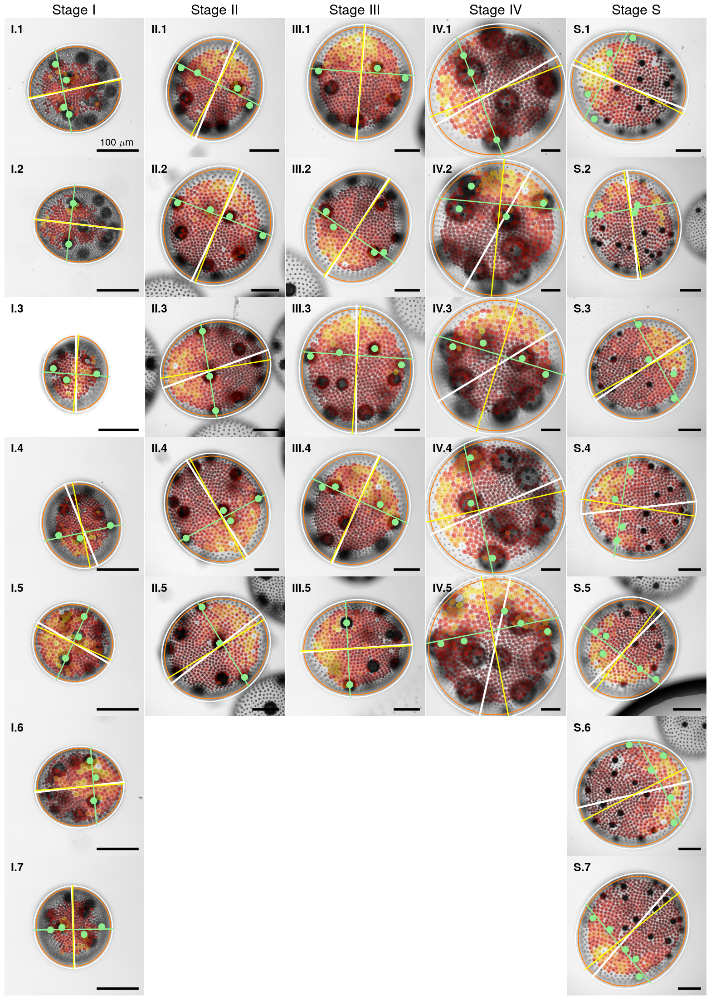

In [26]:
max_n_per_group = max(len(g) for g in gsegs.groups.values())
layout = [
    [f'{name}-{i+1}' for _, __, name, ___ in gsegs.iterate()]
    for i in range(max_n_per_group)
]
fig, axs = pt.default_mosaic(layout)
with_compartments = True

for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    idxs = np.argsort([seg.pathname for seg in segs])
    for i in idxs:
        seg = segs[i]
        ax = axs[layout[i][j]]
        if i == 0:
            pt.title_ax(ax, f'Stage {name}')
        ax.axis('off')
        pt.ax_im_gray(ax, seg.brightfield)
        if with_compartments:
            # areas = seg.metrics['Compartment area']['raw']
            areas = np.array([p.area() for p in seg.orig_polygons])
            pt.ax_planar_polygons(ax, seg.orig_display_polygons, cmap=lambda _: pt.map_colors(areas, 'continuous'), linewidth=0)
        pt.ax_ellipse(ax, seg.display_ellipse, major_axis_color='white', minor_axis_color='none', axes=True, axes_linewidth=3)
        pt.ax_ellipse(ax, seg.display_ellipse * 0.95, major_axis_color='white', minor_axis_color='none', axes=True, axes_linewidth=3)
        seg.plot_ap(ax, linewidth=means_lw, mode='diameter')
        # pt.label_ax(ax, seg.pathname, fontsize=14)
        pt.label_ax(ax, f'{name}.{i+1}', fontsize=18)
        ax.set_xlim(0, seg.brightfield.shape[1])
        ax.set_ylim(seg.brightfield.shape[0], 0)
        pt.ax_scale_bar(ax, 100, upp=seg.upp[0], color='black', units=r'$\mu$m', fontsize=16, label=(i==j==0))
    i += 1
    while i < max_n_per_group:
        ax = axs[layout[i][j]]
        ax.axis('off')
        i += 1
fig.subplots_adjust(wspace=0, hspace=0)
# save_fig(fig, 'Fig_cam_sup_segs_compartments', exts=['png'])
if with_compartments:
    save_fig(fig, 'PhII_figureS5', exts=['pdf'], dpi=150, compressed_dpi=150, jpeg_quality=85)
else:
    save_fig(fig, 'PhII_figureS5', exts=['pdf'], dpi=100, compressed_dpi=100, jpeg_quality=85)


# Diagnostic 2: AP projections

Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/Fig_cam_sup_ap_cellpos.png


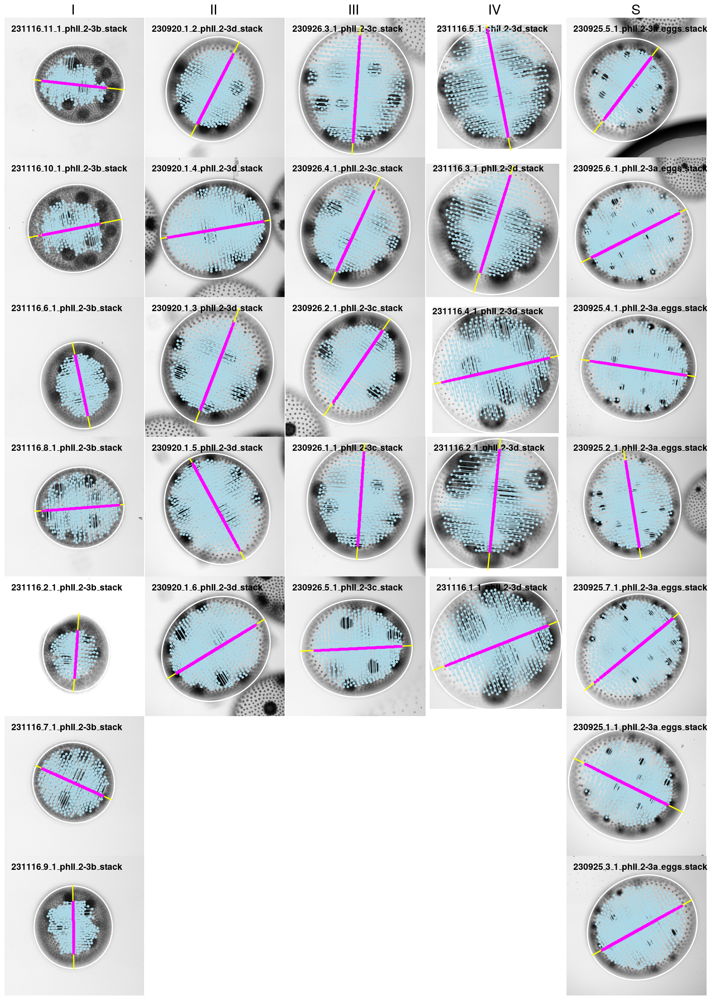

In [11]:
max_n_per_group = max(len(g) for g in gsegs.groups.values())
layout = [
    [f'{name}-{i+1}' for _, __, name, ___ in gsegs.iterate()]
    for i in range(max_n_per_group)
]
fig, axs = pt.default_mosaic(layout)

for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    idxs = np.argsort([seg.pathname for seg in segs])
    for i in idxs:
        seg = segs[i]
        ax = axs[layout[i][j]]
        if i == 0:
            pt.title_ax(ax, name)
        ax.axis('off')
        pt.ax_im_gray(ax, seg.brightfield)
        pts = seg.cell_coms.copy()
        seg.plot_ap(ax, linewidth=means_lw, mode='diameter', pts=pts, gonidia=False)
        pt.label_ax(ax, seg.pathname, fontsize=14)
    i += 1
    while i < max_n_per_group:
        ax = axs[layout[i][j]]
        ax.axis('off')
        i += 1
fig.subplots_adjust(wspace=0, hspace=0)
save_fig(fig, 'Fig_cam_sup_ap_cellpos', exts=['png'])

### Diagnostic 3: offspring

Saved uncompressed figure to /Users/anand/Nextcloud/projects/phii_24/figures/PhII_figureS6.uncompressed.pdf
Saved compressed figure to /Users/anand/Nextcloud/projects/phii_24/figures/PhII_figureS6.pdf
Saved figure to /Users/anand/Nextcloud/projects/phii_24/figures/PhII_figureS6.pdf


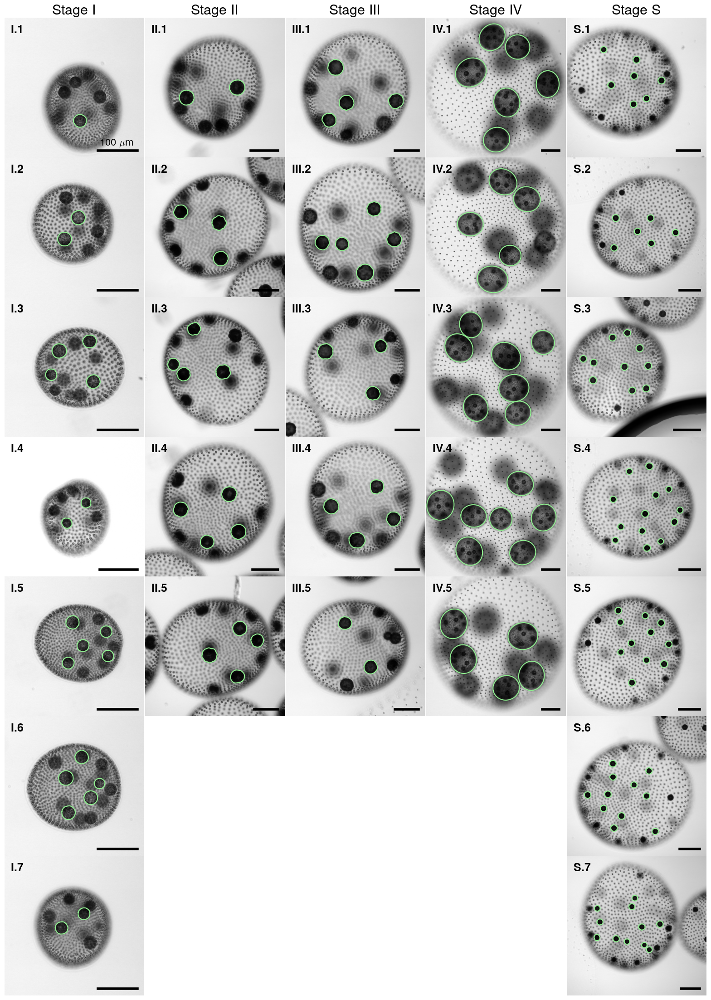

In [9]:
max_n_per_group = max(len(g) for g in gsegs.groups.values())
layout = [
    [f'{name}-{i+1}' for _, __, name, ___ in gsegs.iterate()]
    for i in range(max_n_per_group)
]
fig, axs = pt.default_mosaic(layout)

for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    idxs = np.argsort([seg.pathname for seg in segs])
    for i in idxs:
        seg = segs[i]
        ax = axs[layout[i][j]]
        if i == 0:
            pt.title_ax(ax, f'Stage {name}')
        ax.axis('off')
        zimg = load_stack(seg.img_path)
        zidx = max(enumerate(seg.display_all_offspring), key=lambda x: len(x[1]))[0]
        pt.ax_im_gray(ax, zimg[zidx][:,:,2].transpose())
        offs = [p.transpose() for p in seg.display_all_offspring[zidx]]
        pt.ax_planar_polygons(ax, offs, alpha=0., linecolor='lightgreen', linewidth=1.5)
        pt.label_ax(ax, f'{name}.{i+1}', fontsize=18)
        ax.set_xlim(0, seg.brightfield.shape[1])
        ax.set_ylim(seg.brightfield.shape[0], 0)
        pt.ax_scale_bar(ax, 100, upp=seg.upp[0], color='black', units=r'$\mu$m', fontsize=16, label=(i==j==0))
    i += 1
    while i < max_n_per_group:
        ax = axs[layout[i][j]]
        ax.axis('off')
        i += 1
fig.subplots_adjust(wspace=0, hspace=0)
save_fig(fig, 'PhII_figureS6', exts=['pdf'], dpi=100, compressed_dpi=100, jpeg_quality=85)


# Tables

In [8]:
def format_sf_cols(df_out, df_in, col_pairs, sf, sf_std=None):
    for col, std_col in col_pairs:
        if std_col is None:
            df_out[col] = df_in[col].apply(lambda x: sigfigs.format(x, sf))
        else:
            df_out[col] = df_in.apply(lambda row: sigfigs.format_with_err(row[col], row[std_col], sf, sf_std=sf_std), axis=1)

## Postprocessing

In [36]:
da_postprocess = dict()
rows = []
columns = ['Stage', 'Spheroid', 'Circular radius', 'Segmented cell/compartment pairs']
for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    for i, seg in enumerate(segs):
        seg_name = f'{name}.{i+1}'
        # row = [name, seg_name, len(seg.orig_polygons), len(seg.polygons), len(seg.polygons) / len(seg.orig_polygons)]
        # row = [name, seg_name, seg.outline.circular_radius(), seg.ellipse.get_major_radius(), seg.ellipse.get_minor_radius()]
        row = [name, seg_name, seg.outline.circular_radius(), len(seg.polygons)]
        # assert np.isclose(seg.outline.area(), seg.ellipse.area())
        rows.append(row)
da_postprocess_df = pd.DataFrame(rows, columns=columns)
format_sf_cols(da_postprocess_df, da_postprocess_df, [('Circular radius', None)], 3)
da_postprocess_df.set_index(['Stage', 'Spheroid'])

Circular radius  Segmented cell/compartment pairs
Stage Spheroid                                                  
I     I.1                  117                               249
      I.2                  108                               243
      I.3                 96.2                                86
      I.4                  107                               264
      I.5                  104                               232
      I.6                  109                               227
      I.7                  103                               244
II    II.1                 188                               241
      II.2                 230                               436
      II.3                 221                               416
      II.4                 247                               478
      II.5                 219                               434
III   III.1                245                               385
      III.2                243                               381
      III.3                266                               463
      III.4                241                               419
      III.5                223                               394
IV    IV.1                 416                               475
      IV.2                 419                               419
      IV.3                 419                               427
      IV.4                 428                               513
      IV.5                 430                               498
S     S.1                  254                               331
      S.2                  281                               434
      S.3                  269                               431
      S.4                  278                               496
      S.5                  205                               362
      S.6                  287                               542
      S.7                  280                               507

In [ ]:
da_detailed = dict()
rows = []
columns = [
    'Stage', 'Spheroid', 'Polygon type', 'Area', 'Aspect ratio', 'Circularity'
]
for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    for i, seg in enumerate(segs):
        seg_name = f'{name}.{i+1}'
        for (poly_set, poly_name) in [
            (seg.polygons, 'Compartment'),
            (seg.cell_polygons, 'Cell'),
            (seg.vor_polygons, 'Voronoi'),
        ]:
            for p in poly_set:
                rows.append([name, seg_name, poly_name, p.area(), p.aspect_ratio(), p.isoperimetric_ratio()])
da_detailed_df = pd.DataFrame(rows, columns=columns)
da_detailed_df.to_csv(os.path.join(data_path, 'all_polygon_data.csv'))

,Stage,Spheroid,Polygon type,Area,Aspect ratio,Circularity
0,I,I.1,Compartment,42.422225,1.133993,0.870612
1,I,I.1,Compartment,48.655059,1.404645,0.857113
2,I,I.1,Compartment,41.759986,1.257330,0.864704
3,I,I.1,Compartment,51.966252,1.265724,0.860238
4,I,I.1,Compartment,48.849835,1.677903,0.855642
...,...,...,...,...,...,...
37665,S,S.7,Voronoi,1972.574249,4.799874,0.664815
37666,S,S.7,Voronoi,2701.781370,3.808991,0.720498
37667,S,S.7,Voronoi,4623.779967,1.700197,0.827493
37668,S,S.7,Voronoi,493.998488,1.910962,0.832392


## Sizes

In [18]:
da_sizes = dict()
for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    offs_rad = np.concatenate([np.array([p.circular_radius() for p in seg.all_offspring]) for seg in segs])
    sph_rad = np.array([seg.outline.circular_radius() for seg in segs])
    som_rad = np.concatenate([np.array([p.circular_radius() for p in seg.cell_polygons]) for seg in segs])
    da_sizes[name] = [
        offs_rad.mean(), sph_rad.mean(), som_rad.mean(),
        offs_rad.std(), sph_rad.std(), som_rad.std(),
    ]
cols = [
    'Offspring radius', 'Spheroid radius', 'Somatic cell radius',
    'Offs. r. std.', 'Sph. r. std.', 's.Cell r. std.',
]
da_sizes_df = pd.DataFrame.from_dict(da_sizes, orient='index', columns=cols)

# Parameters
n_avg_cells = 2000
n_avg_offspring = 13
da_sizes_df['Spheroid volume change'] = ((4/3) * np.pi * da_sizes_df['Spheroid radius'] ** 3)[:-1].diff()[1:]
da_sizes_df['Total offspring volume change'] = (n_avg_offspring * (4/3) * np.pi * da_sizes_df['Offspring radius'] ** 3)[:-1].diff()[1:]
da_sizes_df['Total cell volume change'] = (n_avg_cells * (4/3) * np.pi * da_sizes_df['Somatic cell radius'] ** 3)[:-1].diff()[1:]
da_sizes_df['Parental ECM volume change'] = da_sizes_df['Spheroid volume change'] - da_sizes_df['Total cell volume change'] - da_sizes_df['Total offspring volume change']
da_sizes_df[r'\% spheroid volume change to offspring'] = 100 * da_sizes_df['Total offspring volume change'] / da_sizes_df['Spheroid volume change']
da_sizes_df[r'\% spheroid volume change to cells'] = 100 * da_sizes_df['Total cell volume change'] / da_sizes_df['Spheroid volume change']
da_sizes_df['Elapsed'] = pd.Series(np.array([15, 6, 16], dtype=int), index=['II', 'III', 'IV'])
da_sizes_df['Total offspring growth rate'] = da_sizes_df['Total offspring volume change'] / da_sizes_df['Elapsed']
da_sizes_df['Spheroid growth rate'] = da_sizes_df['Spheroid volume change'] / da_sizes_df['Elapsed']
da_sizes_df['Somatic cell growth rate'] = (da_sizes_df['Total cell volume change'] / n_avg_cells) / da_sizes_df['Elapsed']
da_sizes_df['Parental ECM growth rate'] = (da_sizes_df['Parental ECM volume change'] / da_sizes_df['Elapsed'])

# Unit conversions to mm^3
da_sizes_df['Spheroid volume change'] *= 1e-9 
da_sizes_df['Total offspring volume change'] *= 1e-9 
da_sizes_df['Parental ECM volume change'] *= 1e-9 
da_sizes_df['Spheroid growth rate'] *= 1e-9
da_sizes_df['Total offspring growth rate'] *= 1e-9
da_sizes_df['Parental ECM growth rate'] *= 1e-9
da_sizes_df

,Offspring radius,Spheroid radius,Somatic cell radius,Offs. r. std.,Sph. r. std.,s.Cell r. std.,Spheroid volume change,Total offspring volume change,Total cell volume change,Parental ECM volume change,\% spheroid volume change to offspring,\% spheroid volume change to cells,Elapsed,Total offspring growth rate,Spheroid growth rate,Somatic cell growth rate,Parental ECM growth rate
I,15.832268,106.351408,2.865580,1.557830,5.850970,0.426795,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
II,29.091342,221.138099,3.887322,1.601109,19.297216,0.346958,0.040259,0.001125,294987.463534,0.038840,2.793317,0.732718,15.0,0.000075,0.002684,9.832915,0.002589
III,30.396624,243.600208,3.937129,3.993302,13.437090,0.306446,0.015253,0.000189,19159.480459,0.015045,1.237002,0.125611,6.0,0.000031,0.002542,1.596623,0.002508
IV,79.485138,422.481332,4.164975,6.124708,5.567769,0.389399,0.255321,0.025816,94000.656711,0.229411,10.111346,0.036817,16.0,0.001614,0.015958,2.937521,0.014338
S,15.450968,264.826342,4.073258,1.105568,26.451097,0.279522,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
## Sig figs
da_printed_df = pd.DataFrame(index=da_sizes_df.index)
format_sf_cols(da_printed_df, da_sizes_df, [('Elapsed', None)], 2)
format_sf_cols(da_printed_df, da_sizes_df, [('Spheroid radius', 'Sph. r. std.')], 2)
format_sf_cols(da_printed_df, da_sizes_df, [('Offspring radius', 'Offs. r. std.')], 2, sf_std=1)
format_sf_cols(da_printed_df, da_sizes_df, [('Somatic cell radius', 's.Cell r. std.')], 2, sf_std=1)
format_sf_cols(da_printed_df, da_sizes_df, [('Spheroid volume change', None), ('Total offspring volume change', None), ('Total cell volume change', None), ('Parental ECM volume change', None), (r'\% spheroid volume change to offspring', None), (r'\% spheroid volume change to cells', None)], 2)
format_sf_cols(da_printed_df, da_sizes_df, [('Total offspring growth rate', None), ('Parental ECM growth rate', None), ('Spheroid growth rate', None)], 2)
format_sf_cols(da_printed_df, da_sizes_df, [('Somatic cell growth rate', None)], 2, sf_std=1)
units_df = pd.DataFrame({
    r'Spheroid radius': r'\um', r'Offspring radius': r'\um', r'Somatic cell radius': r'\um',
    r'Spheroid volume change': r'\mmcu', r'Total offspring volume change': r'\mmcu', r'Total cell volume change':  r'\umcu', r'Parental ECM volume change': r'\mmcu', r'\% spheroid volume change to offspring': r'\%', r'\% spheroid volume change to cells': r'\%',
    r'Elapsed': r'h',
    r'Spheroid growth rate': r'\mmcu/h', r'Total offspring growth rate': r'\mmcu/h', r'Somatic cell growth rate': r'\umcu/h', r'Parental ECM growth rate': r'\mmcu/h',
}, index=['Units'])
da_printed_df = pd.concat([units_df, da_printed_df])
da_printed_df.to_csv(os.path.join(data_path, 'sizes_rates.csv'))
da_printed_df

,Spheroid radius,Offspring radius,Somatic cell radius,Spheroid volume change,Total offspring volume change,Total cell volume change,Parental ECM volume change,\% spheroid volume change to offspring,\% spheroid volume change to cells,Elapsed,Spheroid growth rate,Total offspring growth rate,Somatic cell growth rate,Parental ECM growth rate
Units,\um,\um,\um,\mmcu,\mmcu,\umcu,\mmcu,\%,\%,h,\mmcu/h,\mmcu/h,\umcu/h,\mmcu/h
I,110 ± 5.9,16 ± 2,2.9 ± 0.4,,,,,,,,,,,
II,220 ± 19,29 ± 2,3.9 ± 0.3,0.040,0.0011,2.9e+05,0.039,2.8,0.73,15,0.0027,7.5e-05,9.8,0.0026
III,240 ± 13,30 ± 4,3.9 ± 0.3,0.015,0.00019,1.9e+04,0.015,1.2,0.13,6.0,0.0025,3.1e-05,1.6,0.0025
IV,420 ± 5.6,79 ± 6,4.2 ± 0.4,0.26,0.026,9.4e+04,0.23,10,0.037,16,0.016,0.0016,2.9,0.014
S,260 ± 26,15 ± 1,4.1 ± 0.3,,,,,,,,,,,


In [90]:
da_printed_df_main = da_printed_df[['Spheroid radius', 'Offspring radius', 'Somatic cell radius', 'Parental ECM volume change', 'Parental ECM growth rate']]
da_printed_df_main.to_csv(os.path.join(data_path, 'sizes_rates_main.csv'))
da_printed_df_main

,Spheroid radius,Offspring radius,Somatic cell radius,Parental ECM volume change,Parental ECM growth rate
Units,\um,\um,\um,\mmcu,\mmcu/h
I,110 ± 5.9,16 ± 2,2.9 ± 0.4,,
II,220 ± 19,29 ± 2,3.9 ± 0.3,0.039,0.0026
III,240 ± 13,30 ± 4,3.9 ± 0.3,0.015,0.0025
IV,420 ± 5.6,79 ± 6,4.2 ± 0.4,0.23,0.014
S,260 ± 26,15 ± 1,4.1 ± 0.3,,


In [91]:
da_printed_df_SI = da_printed_df[['Spheroid volume change', 'Total offspring volume change', 'Total cell volume change', 'Elapsed', 'Spheroid growth rate', 'Total offspring growth rate', 'Somatic cell growth rate']]
da_printed_df_SI.to_csv(os.path.join(data_path, 'sizes_rates_SI.csv'))
da_printed_df_SI

,Spheroid volume change,Total offspring volume change,Total cell volume change,Elapsed,Spheroid growth rate,Total offspring growth rate,Somatic cell growth rate
Units,\mmcu,\mmcu,\umcu,h,\mmcu/h,\mmcu/h,\umcu/h
I,,,,,,,
II,0.040,0.0011,2.9e+05,15,0.0027,7.5e-05,9.8
III,0.015,0.00019,1.9e+04,6.0,0.0025,3.1e-05,1.6
IV,0.26,0.026,9.4e+04,16,0.016,0.0016,2.9
S,,,,,,,


In [85]:
percents_df = pd.DataFrame({
    r'\% v.c. by pECM': da_sizes_df['Parental ECM volume change'] / da_sizes_df['Spheroid volume change'],
    r'\% v.c. by juv': da_sizes_df['Total offspring volume change'] / da_sizes_df['Spheroid volume change'],
    r'\% v.c. by cell': da_sizes_df['Total cell volume change'] / da_sizes_df['Spheroid volume change'],
})
percents_df

,\% v.c. by pECM,\% v.c. by juv,\% v.c. by cell
I,NaN,NaN,NaN
II,0.964740,0.027933,7.327182e+06
III,0.986374,0.012370,1.256112e+06
IV,0.898518,0.101113,3.681666e+05
S,NaN,NaN,NaN


# Close-ups & segmentation

Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure5.uncompressed.pdf


python(44689) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure5.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure5.pdf


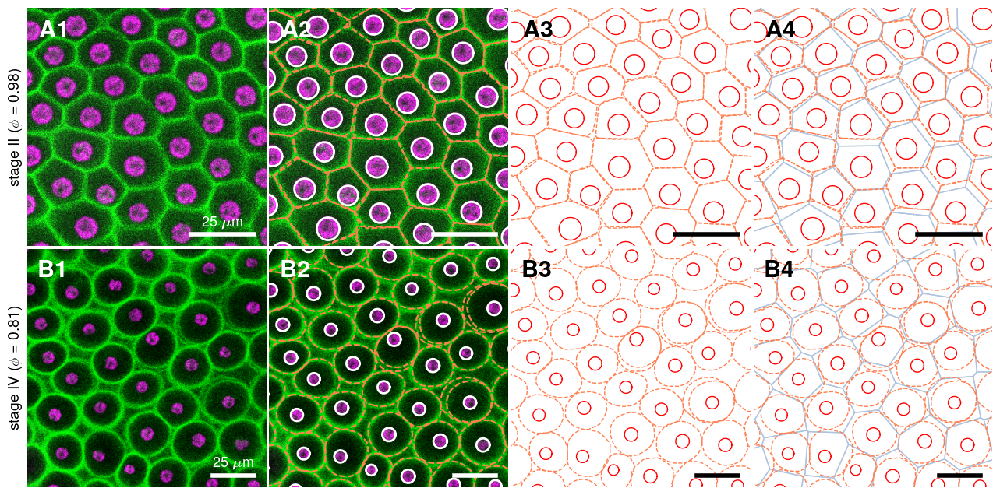

In [13]:
from microseg.utils.data import load_stack, get_voxel_size
from skimage.io import imread
from aicsimageio import AICSImage
import cv2

full_paths = [os.path.join(data_path, f) for f in [
    'II/closeups/Ph2_cYFP_top_view_1_complete_Stack_cropped.tif',
    'IV/closeups/MAX_231116_5_1_phII_2-3d_stack (RGB).tif',
]]
crop_paths = [os.path.join(data_path, f) for f in [
    'II/closeups/Ph2_cYFP_top_view_1_complete_Stack_detail_2.tif',
    'IV/closeups/231116_5_1_phII_2-3d_substack (RGB).tif',
]]
full_imgs = [load_stack(path) for path in full_paths]
crop_imgs = [load_stack(path) for path in crop_paths]
scales = [get_voxel_size(path)[1] for path in full_paths]
pfs = []

def find_crop_pos(full_img, crop_img):
    ''' Match the crop to the original by a search '''
    # Z, C must be the same shape
    assert full_img.shape[0] == crop_img.shape[0]
    assert full_img.shape[-1] == crop_img.shape[-1]
    # X, Y must be contained
    assert full_img.shape[1] >= crop_img.shape[1]
    assert full_img.shape[2] >= crop_img.shape[2]
    # Find crop 
    full_afl, crop_afl = full_img[2], crop_img[2]
    result = cv2.matchTemplate(full_afl, crop_afl, cv2.TM_CCOEFF_NORMED)
    _, __, ___, max_loc = cv2.minMaxLoc(result)
    return max_loc
    
# pad = .3 # Percentage adding on either side
pad = 0 # Percentage adding on either side
cell_color_overlay = 'white'
comp_color_overlay = 'coral'
cell_color = 'red'
comp_color = 'coral'
vor_color = 'lightsteelblue'
layout = [
    [str((i, j)) for j in range(4)] for i in range(2)
]
fig, axs = plt.subplot_mosaic(layout, figsize=(4 * len(layout[0]), 4 * len(layout)))
for i, (full_img, crop_img) in enumerate(zip(full_imgs, crop_imgs)):
    full_name = os.path.splitext(full_paths[i])[0]
    cells_path = f'{full_name}.cells'
    compartments_path = f'{full_name}.compartments'
    assert os.path.isfile(cells_path) and os.path.isfile(compartments_path)
    cells = pickle.load(open(cells_path, 'rb'))
    compartments = pickle.load(open(compartments_path, 'rb'))
    crop_pos = find_crop_pos(full_img, crop_img)
    bdry = PlanarPolygon.from_shape(full_img.shape[1:-1])
    cell_coms = np.array([c.v for c in cells])
    vors = bdry.voronoi_tessellate(cell_coms).polygons
    sub_bdry = PlanarPolygon.from_shape(crop_img.shape[1:-1]) + crop_pos[:2]
    sub_compartments = flatten_list([sub_bdry.intersection(p) for p in compartments])
    sub_packing = PlanarPolygonPacking(sub_bdry, sub_compartments)
    pfs.append(sub_packing.packing_fraction())
    set_label = lambda ax, j, color: pt.label_ax(ax, chars[i].capitalize()+str(j+1), color=color)
    # 1. Chl + YFP
    ax = axs[str((i, 0))]
    set_label(ax, 0, 'white')
    comb_img = np.max([full_img[1], full_img[2]], axis=0)
    ax.imshow(comb_img)
    # 2. Chl + YfP + Segments
    ax = axs[str((i, 1))]
    set_label(ax, 1, 'white')
    ax.imshow(comb_img)
    pt.ax_ellipses(ax, cells, color=cell_color_overlay, linewidth=2)
    # pt.ax_planar_polygons(ax, vors, alpha=0., linecolor=vor_color, linewidth=2)
    pt.ax_planar_polygons(ax, compartments, alpha=0., linecolor=comp_color_overlay, linewidth=1.5, linestyle='--')
    # 3. Segments 
    ax = axs[str((i, 2))]
    set_label(ax, 2, 'black')
    pt.ax_ellipses(ax, cells, color=cell_color, linewidth=1)
    # pt.ax_planar_polygons(ax, vors, alpha=0., linecolor=vor_color, linewidth=1)
    pt.ax_planar_polygons(ax, compartments, alpha=0., linecolor=comp_color, linewidth=1, linestyle='--')
    # # 4. Trans-PMT
    # ax = axs[str((i, 3))]
    # ax.imshow(full_img[0])
    # 4. Segments + Voronoi
    ax = axs[str((i, 3))]
    set_label(ax, 3, 'black')
    pt.ax_ellipses(ax, cells, color=cell_color, linewidth=1)
    pt.ax_planar_polygons(ax, vors, alpha=0., linecolor=vor_color, linewidth=1)
    pt.ax_planar_polygons(ax, compartments, alpha=0., linecolor=comp_color, linewidth=1, linestyle='--')
    # Common formatting
    for j in range(4):
        ax = axs[str((i, j))]
        epsx = pad * crop_img.shape[1]
        epsy = pad * crop_img.shape[2]
        ax.set_xlim(crop_pos[0] - epsx, crop_pos[0] + crop_img.shape[1] + epsx)
        ax.set_ylim(crop_pos[1] + crop_img.shape[2] + epsy, crop_pos[1] - epsy) # Y axis flipped by mpl
        if pad > 0:
            # Plot rect 
            # center = np.array([crop_pos[0] + crop_img.shape[1] / 2, crop_pos[1] + crop_img.shape[2] / 2])
            wh = np.array([crop_img.shape[1], crop_img.shape[2]]) / 2
            # pt.ax_rect(ax, center, wh, color='white', linewidth=1, zorder=10)
            # pt.ax_planar_polygons(ax, [sub_bdry], alpha=0., linecolor='white', linewidth=1, zorder=10)
        pt.ax_scale_bar(ax, 25, color=('white' if j < 2 else 'black'), upp=scales[i], units=r'$\bm{\mu}$m', label=(j==0), fontsize=13)
        ax.axis('off')

pt.left_title_ax(axs[str((0, 0))], f'stage II ($\phi={pfs[0]:.2f}$)', fontsize=14, offset=-0.05)
pt.left_title_ax(axs[str((1, 0))], f'stage IV ($\phi={pfs[1]:.2f}$)', fontsize=14, offset=-0.05)
fig.subplots_adjust(wspace=.01, hspace=.01)
# save_fig(fig, 'Fig_cam_seg_vor', exts=['png'])
save_fig(fig, 'PhII_figure5', exts=['pdf'], dpi=150, compressed_dpi=150, jpeg_quality=85)
# plt.show()

Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS7.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS7.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS7.pdf


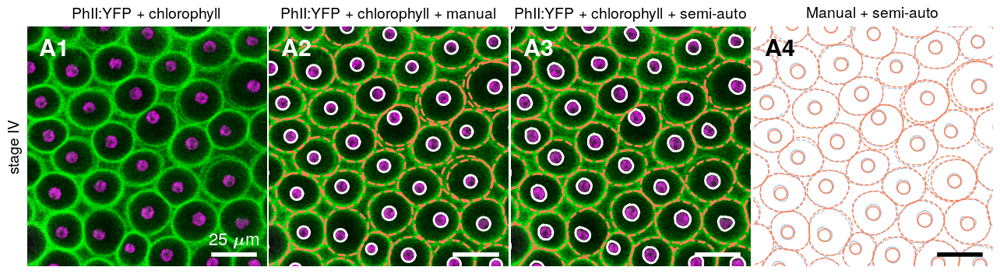

In [70]:
from microseg.utils.data import load_stack, get_voxel_size
from skimage.io import imread
from aicsimageio import AICSImage
import cv2

full_paths = [os.path.join(data_path, f) for f in [
    # 'II/closeups/Ph2_cYFP_top_view_1_complete_Stack_cropped.tif',
    'IV/closeups/MAX_231116_5_1_phII_2-3d_stack (RGB).tif',
]]
crop_paths = [os.path.join(data_path, f) for f in [
    # 'II/closeups/Ph2_cYFP_top_view_1_complete_Stack_detail_2.tif',
    'IV/closeups/231116_5_1_phII_2-3d_substack (RGB).tif',
]]
names = [
    # 'II', 
    'IV',
]
segs = [gsegs.get_by_pathname(name, pathname) for name, pathname in zip(names, [
    # 'Ph2_cYFP_top_view_1_complete_Stack',
    '231116_5_1_phII_2-3d_stack',
])]
full_imgs = [load_stack(path) for path in full_paths]
crop_imgs = [load_stack(path) for path in crop_paths]
scales = [get_voxel_size(path)[1] for path in full_paths]

def find_crop_pos(full_img, crop_img):
    ''' Match the crop to the original by a search '''
    # Z, C must be the same shape
    assert full_img.shape[0] == crop_img.shape[0]
    assert full_img.shape[-1] == crop_img.shape[-1]
    # X, Y must be contained
    assert full_img.shape[1] >= crop_img.shape[1]
    assert full_img.shape[2] >= crop_img.shape[2]
    # Find crop 
    full_afl, crop_afl = full_img[2], crop_img[2]
    result = cv2.matchTemplate(full_afl, crop_afl, cv2.TM_CCOEFF_NORMED)
    _, __, ___, max_loc = cv2.minMaxLoc(result)
    return max_loc
    
# pad = .3 # Percentage adding on either side
pad = 0 # Percentage adding on either side
cell_color_overlay = 'white'
comp_color_overlay = 'coral'
cell_color = 'red'
comp_color = 'coral'
vor_color = 'lightsteelblue'
layout = [
    [str((i, j)) for j in range(4)] for i in range(len(full_paths))
]
fig, axs = plt.subplot_mosaic(layout, figsize=(4 * len(layout[0]), 4 * len(layout)))
for i, (full_img, crop_img, seg) in enumerate(zip(full_imgs, crop_imgs, segs)):
    full_name = os.path.splitext(full_paths[i])[0]
    cells_path = f'{full_name}.cells'
    compartments_path = f'{full_name}.compartments'
    assert os.path.isfile(cells_path) and os.path.isfile(compartments_path)
    cells = pickle.load(open(cells_path, 'rb'))
    compartments = pickle.load(open(compartments_path, 'rb'))
    bdry = PlanarPolygon.from_shape(full_img.shape[1:-1])
    cell_coms = np.array([c.v for c in cells])
    set_title = lambda ax, j, color: pt.label_ax(ax, chars[i].capitalize()+str(j+1), color=color)
    
    # 1. Chl + YFP
    ax = axs[str((i, 0))]
    set_title(ax, 0, 'white')
    pt.title_ax(ax, 'PhII:YFP + chlorophyll', fontsize=14)
    comb_img = np.max([full_img[1], full_img[2]], axis=0)
    ax.imshow(comb_img)
    
    # 2. Chl + YFP + Hand segments
    ax = axs[str((i, 1))]
    set_title(ax, 1, 'white')
    pt.title_ax(ax, 'PhII:YFP + chlorophyll + manual', fontsize=14)
    ax.imshow(comb_img)
    pt.ax_ellipses(ax, cells, color=cell_color_overlay, linewidth=2)
    pt.ax_planar_polygons(ax, compartments, alpha=0., linecolor=comp_color_overlay, linewidth=2, linestyle='--')

    # 3. Chl + YFP + Auto segments
    ax = axs[str((i, 2))]
    set_title(ax, 2, 'white')
    pt.title_ax(ax, 'PhII:YFP + chlorophyll + semi-auto', fontsize=14)
    ax.imshow(comb_img)
    # pt.ax_ellipses(ax, cells, color=cell_color_overlay, linewidth=2)
    pt.ax_planar_polygons(ax, seg.display_cell_polygons, alpha=0., linecolor=cell_color_overlay, linewidth=2)
    pt.ax_planar_polygons(ax, seg.display_polygons, alpha=0., linecolor=comp_color_overlay, linewidth=2, linestyle='--')

    # 4. Manual + Auto segments
    ax = axs[str((i, 3))]
    set_title(ax, 3, 'black')
    pt.title_ax(ax, 'Manual + semi-auto', fontsize=14)
    pt.ax_planar_polygons(ax, seg.display_cell_polygons, alpha=0., linecolor=vor_color, linewidth=1)
    pt.ax_ellipses(ax, cells, color=comp_color, linewidth=1)
    pt.ax_planar_polygons(ax, seg.display_polygons, alpha=0., linecolor=vor_color, linewidth=1, linestyle='--')
    pt.ax_planar_polygons(ax, compartments, alpha=0., linecolor=comp_color, linewidth=1, linestyle='--')

    # Common formatting
    crop_pos = find_crop_pos(full_img, crop_img)
    for j in range(4):
        ax = axs[str((i, j))]
        epsx = pad * crop_img.shape[1]
        epsy = pad * crop_img.shape[2]
        ax.set_xlim(crop_pos[0] - epsx, crop_pos[0] + crop_img.shape[1] + epsx)
        ax.set_ylim(crop_pos[1] + crop_img.shape[2] + epsy, crop_pos[1] - epsy) # Y axis flipped by mpl
        if pad > 0:
            # Plot rect 
            center = np.array([crop_pos[0] + crop_img.shape[1] / 2, crop_pos[1] + crop_img.shape[2] / 2])
            wh = np.array([crop_img.shape[1], crop_img.shape[2]]) / 2
            pt.ax_rect(ax, center, wh, color='white', linewidth=1, zorder=10)
        pt.ax_scale_bar(ax, 25, color=('white' if j < 3 else 'black'), upp=scales[i], units=r'$\bm{\mu}$m', label=(j==0))
        ax.axis('off')

for i, name in enumerate(names):
    pt.left_title_ax(axs[str((i, 0))], f'stage {name}', fontsize=14)
fig.subplots_adjust(wspace=.01, hspace=.01)
# save_fig(fig, 'Fig_cam_sup_seg_comparison', exts=['png'])
save_fig(fig, 'PhII_figureS7', exts=['pdf'], dpi=150, jpeg_quality=85)

Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure1D.png


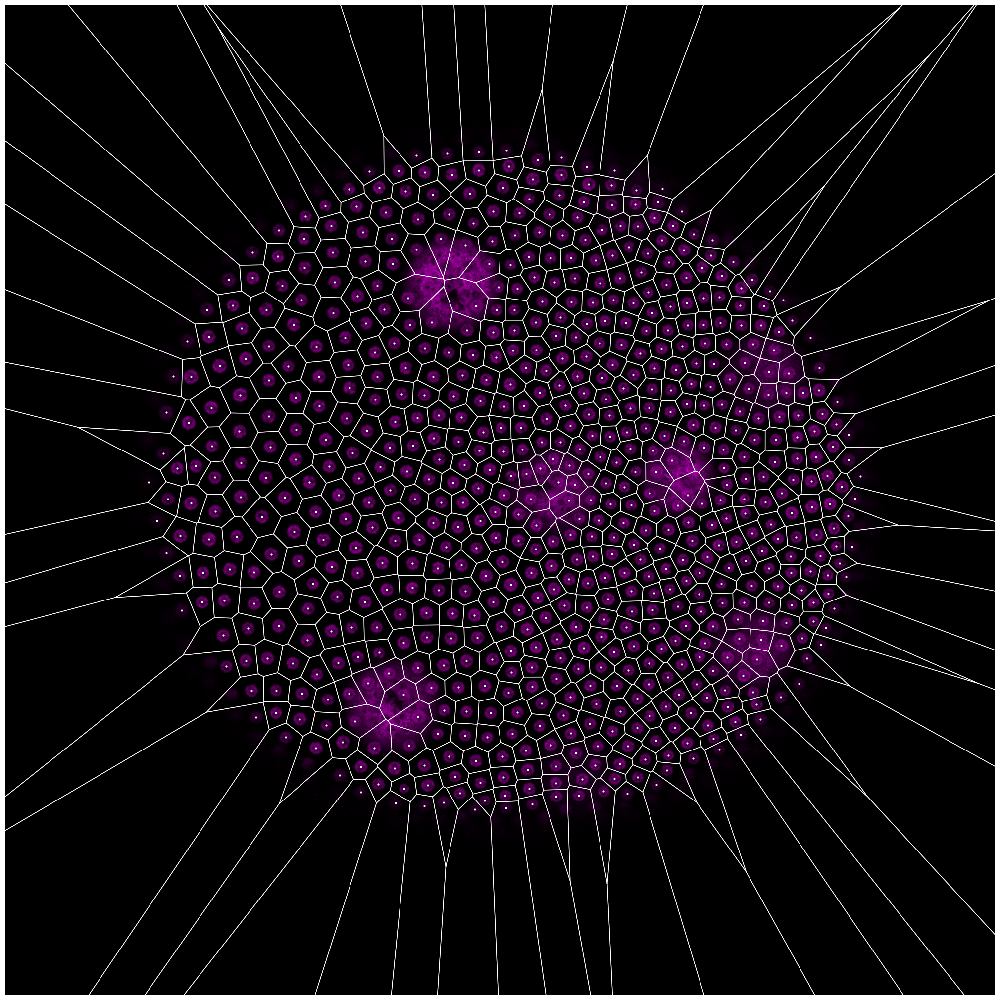

In [44]:
from microseg.utils.data import load_XY_image

img = load_XY_image('/Users/asrvsn/Downloads/Re_ Fig 1C/ph2_1C_C.pdf', gray=False)
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
ax.axis('off')
ax.imshow(img)

show_vor = True
if show_vor:
    polys = [l.asPoly() for l in pickle.load(open('/Users/asrvsn/Downloads/Re_ Fig 1C/ph2_1C_C.cells', 'rb'))]
    # coms = np.array([p.centroid() for p in polys]) - np.array([0.7, 0.7]) # 1-pixel offset somewhere?
    coms = np.array([p.centroid() for p in polys]) - np.array([1, 1]) # 1-pixel offset somewhere?
    ax.scatter(coms[:, 0], coms[:, 1], s=4, color='white') 
    vor_polys = PlanarPolygon.from_shape(img.shape[:2]).voronoi_tessellate(coms).polygons
    pt.ax_planar_polygons(ax, vor_polys, alpha=0., linecolor='white', linewidth=1)

ax.set_xlim(0, img.shape[1])
ax.set_ylim(img.shape[0], 0)
fig.subplots_adjust(left=0., right=1., bottom=0.0, top=1.)
# save_fig(fig, 'PhII_figure1D', exts=['pdf'], dpi=150, compressed_dpi=150, jpeg_quality=100)
if show_vor:
    save_fig(fig, 'PhII_figure1D', exts=['png'], dpi=300, autorasterize=False)
else:
    save_fig(fig, 'PhII_figure1C', exts=['png'], dpi=300, autorasterize=False)

# Spheroid metrics

In [15]:
def make_spheroid_metrics(seg_metrics: List[str], ncols: int=3):
    assert len(seg_metrics) % ncols == 0
    layout = np.array([
        [f'({chars[i]})' for i in range(len(seg_metrics))]
    ])
    # Reshape layout to ncols
    layout = layout.reshape(-1, ncols)
    fig, axs = plt.subplot_mosaic(layout, figsize=(4 * len(layout[0]), 4 * len(layout)))
    for i, metric in enumerate(seg_metrics):
        r, c = np.unravel_index(i, layout.shape)
        ax = axs[layout[r][c]]
        name = seg_metric_metadata[metric]['label']
        ax.set_xlabel(metric, fontsize=label_fs)
        pt.label_ax(ax, i, fontsize=int(title_fs*1.35))
        if c == 0:
            ax.set_yticks(np.arange(gsegs.n_groups))
            ax.set_yticklabels([name for _, _, name, _ in gsegs.iterate()])
        else:
            ax.set_yticklabels([])
        for i, (k, segs, __, ___) in enumerate(gsegs.iterate()):
            data = np.array([seg.seg_metrics[metric] for seg in segs])
            N_segs = len(segs)
            # Color by segmentation
            ax.scatter(data, i * np.ones(N_segs), s=60, edgecolors=gsegs.colors[k], facecolors='none')
            ax.plot([data.mean(), data.mean()], [i - 0.5, i + 0.5], c=gsegs.colors[k], linewidth=means_lw)
        print(metric)
        if seg_metric_metadata[metric]['log']:
            ax.set_xscale('log')
        ax.tick_params(axis='y', labelsize=label_fs)
        ax.tick_params(axis='x', labelsize=label_fs)
        # ax.set_xlabel(seg_metric_metadata[metric]['label'], fontsize=label_fs)
    fig.subplots_adjust(hspace=0.3, wspace=0.05)
    return fig, axs

$k_{\rm gamma}(\alpha)$
$k_{\rm gamma}(a_{\rm cz3})$
Sum of second moments
Median Voronoi error
Spheroid radius
Spheroid aspect ratio
Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure10.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure10.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure10.pdf


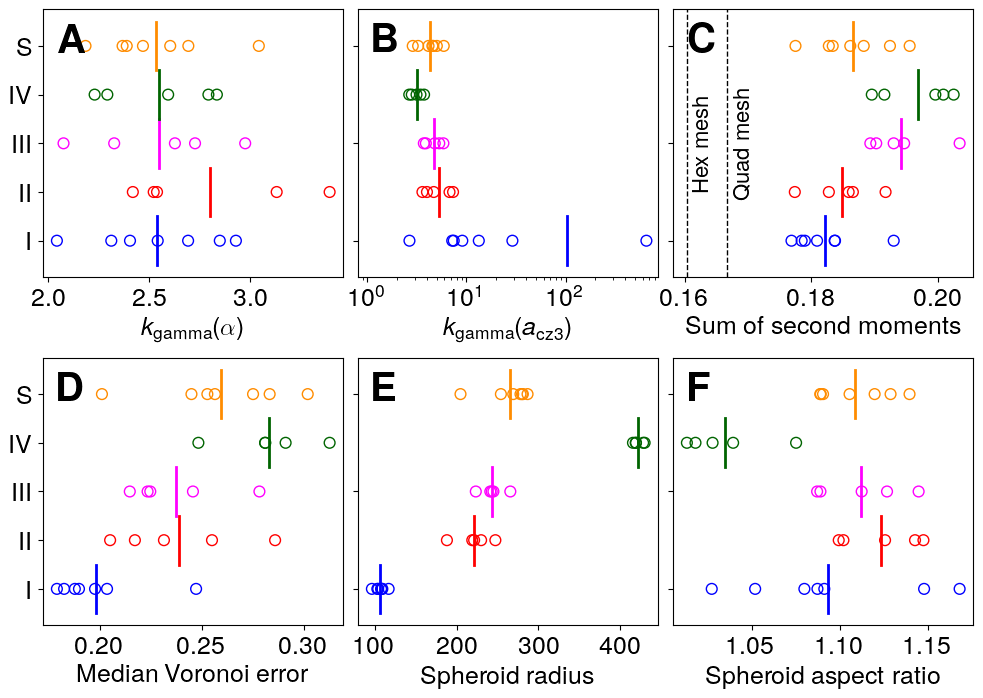

In [16]:
seg_metrics = [r'$k_{\rm gamma}(\alpha)$', r'$k_{\rm gamma}(a_{\rm cz3})$', r'Sum of second moments', 'Median Voronoi error', 'Spheroid radius', 'Spheroid aspect ratio']
fig, axs = make_spheroid_metrics(seg_metrics, ncols=3)
# Draw vertical line at QE for n-cell tessellations
for n, name in zip([6, 4], ['Hex', 'Quad']):
    n_eq = PlanarPolygon.trace_M2_ngon(n)
    axs['(c)'].axvline(n_eq, color='k', linestyle='--', linewidth=ind_lw)
    axs['(c)'].text(n_eq*1.005, 2, f'{name} mesh', fontsize=ticks_fs, ha='left', va='center', rotation=90)
pad_left_ax(axs['(b)'], 0.15)
# save_fig(fig, 'Fig_cam_packing')
save_fig(fig, 'PhII_figure10', exts=['pdf'], dpi=150, compressed_dpi=150, autorasterize=False)

$k_{\rm gamma}(a_{\rm cz3})$
$k_{\rm gamma}(a_{\rm cz3})$ (anterior)
$k_{\rm gamma}(a_{\rm cz3})$ (posterior)
$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$
$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$ (anterior)
$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$ (posterior)
Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS11.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS11.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS11.pdf


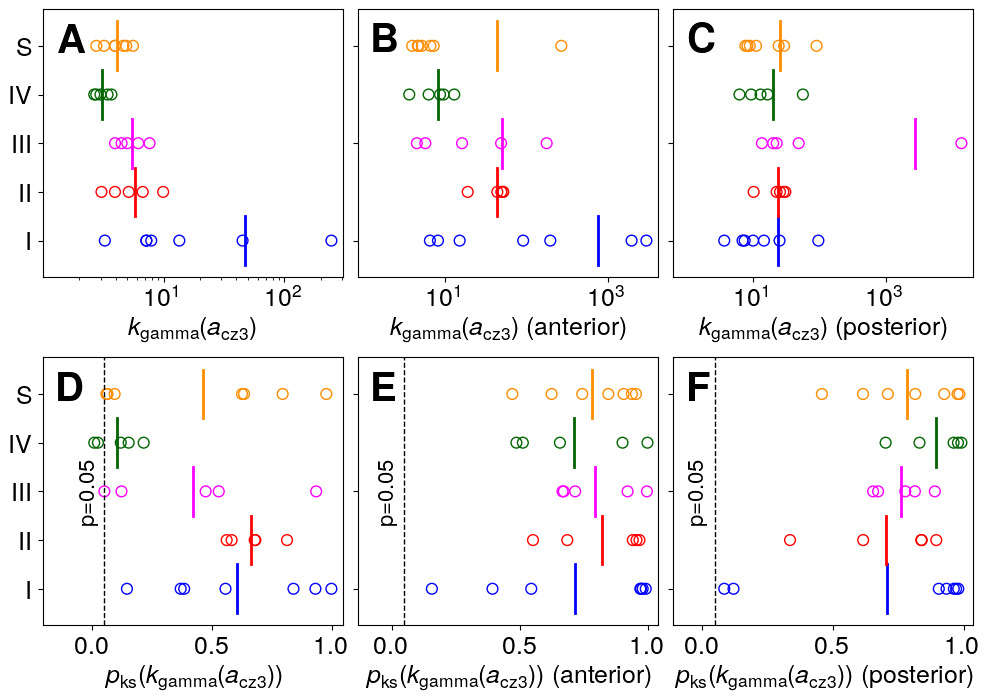

In [24]:
seg_metrics = [
    r'$k_{\rm gamma}(a_{\rm cz3})$', r'$k_{\rm gamma}(a_{\rm cz3})$ (anterior)', r'$k_{\rm gamma}(a_{\rm cz3})$ (posterior)',
    r'$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$', r'$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$ (anterior)', r'$p_{\rm ks} (k_{\rm gamma}(a_{\rm cz3}))$ (posterior)'
]
fig, axs = make_spheroid_metrics(seg_metrics, ncols=3)
for ax in axs.values():
    pad_left_ax(ax, 0.15)
for axk in ['(d)', '(e)', '(f)']:
    axs[axk].axvline(0.05, color='k', linestyle='--', linewidth=ind_lw)
    axs[axk].text(-0.02, 2, f'p={0.05}', fontsize=ticks_fs, ha='center', va='center', rotation=90)
pad_left_ax(axs['(e)'], 0.1)
save_fig(fig, 'PhII_figureS11', exts=['pdf'], dpi=150, compressed_dpi=150, autorasterize=False)

# Anterior-posterior and lifecycle metrics

In [17]:
def make_ap_fig(metrics: List[str], ap_mode: str='raw', err_mode: str='stddev', ap_bins: int=8, fmult: float=1.0, xsize: float=5.5, ysize: float=3.6, orientation='horizontal', no_hists: bool=False, hist_bins: int=100, means: bool=True):
    my_ticks_fs = ticks_fs * 1.
    y_title_fs = title_fs * 1.1
    N = len(metrics)
    layout = [
        list(range(N)),
        list(range(N, 2 * N)),
    ]
    if no_hists:
        layout = layout[:1]
    if orientation == 'horizontal':
        pass
    elif orientation == 'vertical':
        layout = np.array(layout).T.tolist()
    else:
        raise ValueError('orientation must be either "horizontal" or "vertical"')
    fig, axs = plt.subplot_mosaic(layout, figsize=(xsize * len(layout[0]), ysize * len(layout)))
    df_cols = []
    df_data = []

    # Draw
    for i, metric in enumerate(metrics):
        print(f'Processing metric {metric}')
        units = metric_metadata[metric]["units"]
        df_data.append([])
        label = f'{metric} ({units})' if units != 'unitless' else metric

        # Col 1: Mean AP
        j = 0 
        ax = axs[layout[j][i]] if orientation == 'horizontal' else axs[layout[i][j]]
        pt.left_title_ax(ax, metric, fontsize=int(fmult*y_title_fs), offset=-0.275)
        for k, segs, name, leg_name in gsegs.iterate():
            ap_pos_metric = metric_metadata[metric]['ap_pos_metric']
            group_xvals, group_yvals = [], []
            for seg in segs:
                yvals = seg.metrics[metric]['raw'].copy()
                positions = seg.metrics[ap_pos_metric]['raw'].copy() - seg.ellipse.v
                assert positions.shape == (yvals.shape[0], 2)
                lengths = la.norm(positions, axis=1)
                signs = np.sign(positions @ seg.get_ap_axis())
                assert lengths.shape == signs.shape
                xvals = lengths * signs / (seg.seg_metrics['AP radius'] * 2) # Convert 2D positions to percentages along AP axis
                group_xvals.append(xvals)
                group_yvals.append(yvals)
            group_xvals, group_yvals = np.concatenate(group_xvals), np.concatenate(group_yvals)
            if ap_mode == 'raw':
                ax.scatter(group_xvals, group_yvals, color=gsegs.colors[k], s=0.5, alpha=0.5)
            elif ap_mode == 'binned':
                if i == 0:
                    df_cols.append(r'\% change PA in ' + name)
                bin_means, bin_edges, _ = stats.binned_statistic(group_xvals, group_yvals, statistic='mean', bins=ap_bins)
                df_data[i].append(100 * (bin_means[-1] / bin_means[0] - 1))
                # print(f'Percent change {metric} along P-A Stage {name}: {bin_means[-1] / bin_means[0] - 1:.1%}')
                # print(f'Absolute change {metric} P-A Stage {name}: {bin_means[-1] - bin_means[0]:.2f} ({metric_metadata[metric]["units"]})')
                bin_std, _, _ = stats.binned_statistic(group_xvals, group_yvals, statistic='std', bins=ap_bins)
                bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
                ax.fill_between(bin_centers, bin_means+bin_std, bin_means-bin_std, color=gsegs.colors[k], alpha=0.1)
                # ax.errorbar(bin_centers, bin_means, yerr=bin_std, fmt='none', ecolor=gsegs.colors[k], capsize=2)
                ax.plot(bin_centers, bin_means, linewidth=group_lw*2, color=gsegs.colors[k], zorder=10, linestyle='--')
            else:
                raise ValueError(f'Invalid ap_mode {ap_mode}')
        # To the existing set of ticks, append "P" and "A" at group_xvals[0], group_xvals[-1]
        ticks = [-0.5, -0.25, 0, 0.25, 0.5]
        ax.set_xticks(ticks)
        ax.set_xticklabels([str(int((t+0.5)*100)) for t in ticks]) # Convert to range [0, 100%] from posterior to anterior
        ax.set_xlabel(r'\% PA axis', fontsize=int(1.1*title_fs))
        ax.tick_params(axis='x', labelsize=int(fmult*my_ticks_fs))
        ax.tick_params(axis='y', labelsize=int(fmult*my_ticks_fs))
        pt.label_ax(ax, f'{upperchars[i]}{j+1}', fontsize=int(fmult*title_fs))

        # Col 2: empirical distributions
        if not no_hists:
            j = 1
            ax = axs[layout[j][i]] if orientation == 'horizontal' else axs[layout[i][j]]
            metric_data = dict()
            colors = dict()
            last_name = None
            last_val = None
            for k, segs, name, leg_name in gsegs.iterate():
                s_data = np.concatenate([
                    seg.metrics[metric]['raw'] for seg in segs
                ])
                metric_data[name] = s_data.copy()
                colors[name] = gsegs.colors[k]
                if name != 'S':
                    if i == 0:
                        if last_name is None:
                            df_cols.append(f'Mean value in stage {name}')
                        else:
                            df_cols.append(r'\% change mean ' + f'{last_name} to {name}')
                            df_cols.append(f'Mean value in stage {name}')
                    cur_val = s_data.mean()
                    if last_name is None:
                        df_data[i].append(cur_val)
                    else:
                        # print(f'Percent change {metric} in mean Stage {last_name} to {name}: {cur_val / last_val - 1:.1%}')
                        df_data[i].append(100 * (cur_val / last_val - 1))
                        df_data[i].append(cur_val)
                last_name = name
                last_val = s_data.mean()
            plot_violin_rvs(ax, metric_data, rvs=metric_metadata[metric]['rvs'], bins=hist_bins, means=means, colors=colors, linewidth=2*means_lw)
            ax.tick_params(axis='x', labelsize=int(fmult*my_ticks_fs))
            ax.tick_params(axis='y', labelsize=int(fmult*my_ticks_fs))
            ax.set_xlabel(label, fontsize=int(1.1*title_fs))
            # Address some units-specific axes labeling here
            if units == 'count':
                ax.xaxis.set_major_locator(MaxNLocator(integer=True))
            # ax.set_ylabel('Frequency', fontsize=int(fmult*title_fs))
            pt.label_ax(ax, i if no_hists else f'{upperchars[i]}{j+1}', fontsize=int(fmult*title_fs))

    if no_hists:
        df = None
    else:
        assert len(metrics) == len(df_data)
        assert len(df_cols) == len(df_data[0])
        df = pd.DataFrame(df_data, index=metrics, columns=df_cols).T

    return layout, fig, axs, df

Processing metric Cell area
Processing metric Compartment area
Processing metric Aspect ratio
Processing metric Circularity
Processing metric Offset
Processing metric Offset (whitened)
Processing metric Voronoi error
Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure8.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure8.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure8.pdf


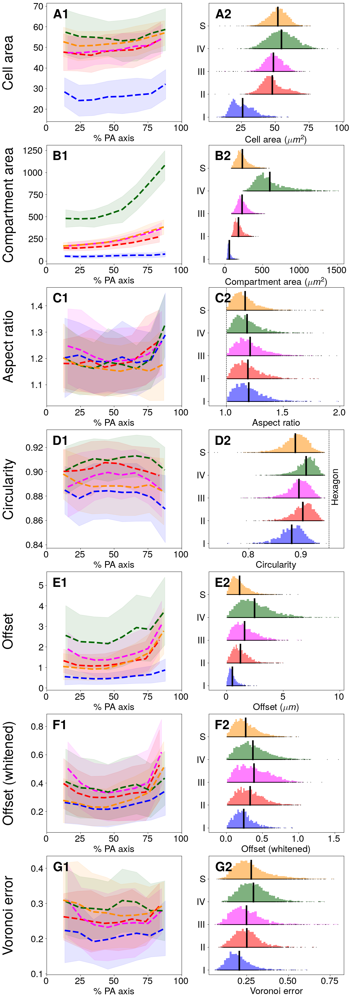

In [18]:
orientation = 'vertical'
layout, fig, axs, pa_df = make_ap_fig(['Cell area', 'Compartment area', 'Aspect ratio', 'Circularity', 'Offset', 'Offset (whitened)', 'Voronoi error'], ap_mode='binned', fmult=1.5, orientation=orientation)
# Draw lines for 5/6 gons ID
layout = np.array(layout).T if orientation == 'vertical' else layout
axk = layout[1][3]
for n, name in [(6, 'Hexagon')]:
    n_ir = PlanarPolygon.ir_ngon(n)
    axs[axk].axvline(n_ir, color='k', linestyle='--', linewidth=ind_lw)
    axs[axk].text(n_ir*1.005, 2.5, name, fontsize=title_fs*1.1, ha='left', va='center', rotation=90)
axs[layout[1][2]].axvline(1, color='k', linestyle='--', linewidth=ind_lw)
# pad_top_ax(axs[layout[0][0]])
# pad_top_ax(axs[layout[0][-1]])
pad_left_ax(axs[layout[1][1]])
pad_left_ax(axs[layout[1][2]])
pad_right_ax(axs[layout[1][3]])
pad_left_ax(axs[layout[1][4]])
# pad_left_ax(axs[layout[1][4]])
pad_left_ax(axs[layout[1][5]])
fig.subplots_adjust(hspace=0.2, wspace=0.2, top=1.5, right=1.1)
# save_fig(fig, 'Fig_cam_ap_dist', exts=['png'])
save_fig(fig, 'PhII_figure8', exts=['pdf'], dpi=200, compressed_dpi=200, autorasterize=True)

In [84]:
pa_df.round(2)

,Cell area,Compartment area,Aspect ratio,Circularity,Offset,Offset (whitened),Voronoi error
\% change PA in I,13.72,44.25,9.85,-2.49,46.90,22.59,1.66
\% change PA in II,13.44,93.90,3.06,-0.69,117.00,65.15,15.61
\% change PA in III,13.28,121.88,1.01,-0.67,82.04,36.93,-6.55
\% change PA in IV,8.12,129.56,14.39,-0.53,49.86,8.72,-10.31
\% change PA in S,9.90,128.90,-1.76,-1.94,195.36,105.17,-3.06
Mean value in stage I,26.37,57.85,1.20,0.88,0.54,0.24,0.21
\% change mean I to II,81.47,201.09,0.93,1.95,141.60,43.29,21.60
Mean value in stage II,47.85,174.18,1.21,0.90,1.29,0.35,0.25
\% change mean II to III,2.38,30.02,0.86,-0.78,27.36,12.05,-1.41
Mean value in stage III,48.99,226.48,1.22,0.89,1.65,0.39,0.25


Processing metric Offset angle
Processing metric Voronoi neighbors
Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS10.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS10.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS10.pdf


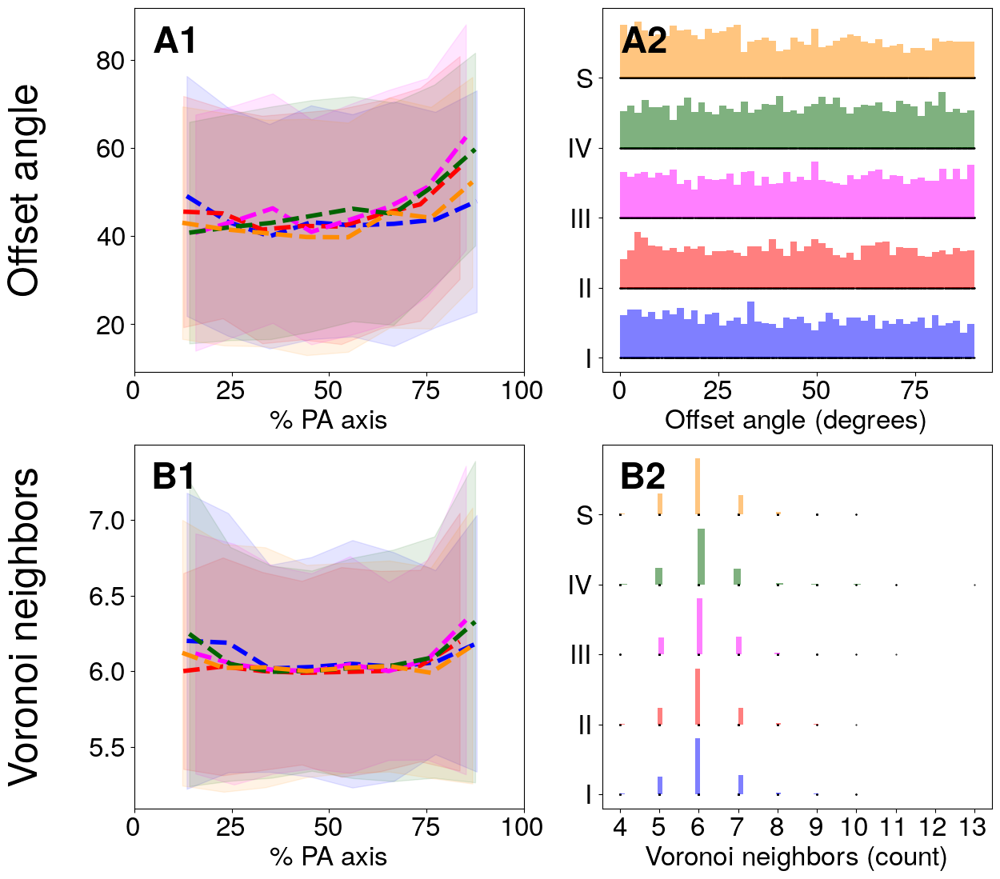

In [19]:
orientation = 'vertical'
layout, fig, axs, _ = make_ap_fig(['Offset angle', 'Voronoi neighbors'], ap_mode='binned', fmult=1.5, orientation=orientation, means=False)
fig.subplots_adjust(hspace=0.2, wspace=0.2, top=1.5, right=1.1)
# save_fig(fig, 'PhII_sup_ap_metrics', exts=['png'])
save_fig(fig, 'PhII_figureS10', exts=['pdf'], dpi=150, autorasterize=True)

## Voronoi neighbors

5-gon frequency: 312
7-gon frequency: 370
5-gon frequency: 449
7-gon frequency: 462
5-gon frequency: 400
7-gon frequency: 431
5-gon frequency: 433
7-gon frequency: 442
5-gon frequency: 694
7-gon frequency: 683
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/Fig_cam_sup_neighbors.pdf


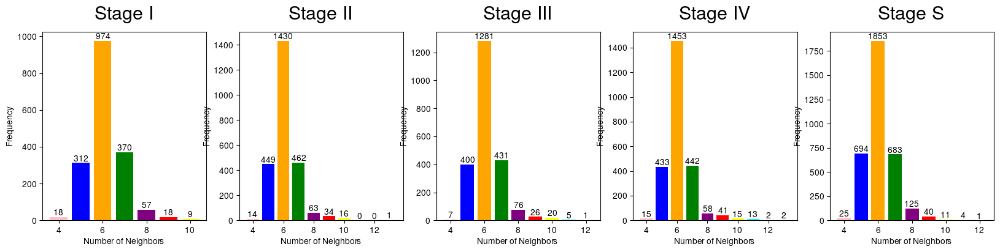

In [37]:
from asrvsn_mpl.neighbors import nb_hist

layout = [
    list(range(5))
]
fig, axs = pt.default_mosaic(layout)

for j, (_, segs, name, __) in enumerate(gsegs.iterate()):
    # if j < 2: # Only stages I, II
    ax = axs[layout[0][j]]
    neighbors = []
    for seg in segs:
        neighbors.append(seg.metrics['Voronoi neighbors']['raw'].copy())
    neighbors = np.concatenate(neighbors)
    nb_hist(ax, neighbors, show_nums=True)
    # pt.label_ax(ax, j)
    pt.title_ax(ax, f'Stage {name}')
# fig.subplots_adjust(wspace=0, hspace=0)
save_fig(fig, 'Fig_cam_sup_neighbors', exts=['pdf'])

# Correlations

In [20]:
def plot_corr(
            metric_pairs: List[List[Tuple[str, str, str]]], 
            mode='scatter', fmult: float=1, apply_corr_transform: bool=True, xlabel_all: bool=False, separate_ap: bool=False, showwhich: bool=False, corr: bool=True,
    ):
    layout = [[str(pair) for pair in sublist] for sublist in metric_pairs]
    fig, axs = plt.subplot_mosaic(layout, figsize=(5 * len(layout[0]), 4 * len(layout)))
    for i, sublist in enumerate(metric_pairs):
        for j, (metric_x, metric_y, whichones) in enumerate(sublist):
            n = i * len(sublist) + j
            assert metric_x != metric_y
            name_x, name_y = metric_metadata[metric_x]['short_name'], metric_metadata[metric_y]['short_name']
            # print(f'Processing metric {name_x} / {name_y}')
            if apply_corr_transform:
                x_fn, y_fn = metric_metadata[metric_x]['corr_transform'], metric_metadata[metric_y]['corr_transform']
            else:
                x_fn, y_fn = lambda x: x, lambda x: x
            
            # Pair plot
            ax = axs[str((metric_x, metric_y, whichones))]
            if i == len(metric_pairs) - 1 or xlabel_all:
                mxlabel = metric_metadata[metric_x]['corr_transform_label'] if apply_corr_transform else metric_metadata[metric_x]['label']
                ax.set_xlabel(mxlabel, fontsize=int(fmult*label_fs))
            else:
                ax.set_xticklabels([])
            mylabel = metric_metadata[metric_y]['corr_transform_label'] if apply_corr_transform else metric_metadata[metric_y]['label']
            ax.set_ylabel(mylabel, fontsize=int(fmult*label_fs))

            if whichones == 'all':
                whichones = {'I', 'II', 'III', 'IV', 'S'}
            assert isinstance(whichones, set) and whichones.issubset(gsegs.names.keys())
            all_x, all_y = [], []
            for k, segs, name, leg_name in gsegs.iterate():
                if name in whichones:
                    group_x = np.concatenate([
                        seg.metrics[metric_x]['raw'] for seg in segs
                    ])
                    group_y = np.concatenate([
                        seg.metrics[metric_y]['raw'] for seg in segs
                    ])
                    ant_index = np.concatenate([seg.get_hemisphere_index('anterior', 'Compartment AP position') for seg in segs])
                    assert len(ant_index) == len(group_x) == len(group_y)
                    
                    # Apply coordinate transforms
                    group_x = x_fn(group_x)
                    group_y = y_fn(group_y)
                    all_x.append(group_x)
                    all_y.append(group_y)

                    if mode == 'scatter':
                        if separate_ap:
                            ax.scatter(group_x[ant_index], group_y[ant_index], s=2, alpha=scatter_alpha, color=gsegs.colors[k]) 
                            ax.scatter(group_x[~ant_index], group_y[~ant_index], s=2, alpha=scatter_alpha, color=gsegs.colors[k])
                        else:
                            ax.scatter(group_x, group_y, s=0.5, alpha=scatter_alpha, color=gsegs.colors[k])
                    elif mode == 'kde':
                        sns.kdeplot(ax=ax, x=group_x, y=group_y, color=gsegs.colors[k], levels=n_contours, alpha=contour_alpha)
                        ax.plot(group_x.mean(), group_y.mean(), marker='*', color=gsegs.colors[k], markersize=20)
                    else:
                        raise ValueError(f'Invalid mode {mode}')
            all_x, all_y = np.concatenate(all_x), np.concatenate(all_y)

            # Regressions
            if corr:
                corr_metrics = frozenset({metric_x, metric_y})
                if corr_metrics in cross_linear_regressions:
                    # print(f'Processing regression {name_x} / {name_y}')
                    corr_x, corr_y = [], []
                    corr_names = cross_linear_regressions[corr_metrics] & whichones  # Groups to be included in regression
                    for _, segs, name, __ in gsegs.iterate():
                        if name in corr_names:
                            corr_x.append(np.concatenate([seg.metrics[metric_x]['raw'] for seg in segs]))
                            corr_y.append(np.concatenate([seg.metrics[metric_y]['raw'] for seg in segs]))
                    corr_x, corr_y = np.concatenate(corr_x), np.concatenate(corr_y)
                    corr_x = x_fn(corr_x)
                    corr_y = y_fn(corr_y)
                    slope, intercept, r_value, p_value, std_err = stats.linregress(corr_x, corr_y)
                    x = np.linspace(np.min(all_x), np.max(all_x), 100)
                    y = slope * x + intercept
                    ax.plot(x, y, color='black', linestyle='--', linewidth=means_lw)
                    corr_title = f'({", ".join([x.strip() for x in sorted(list(corr_names))])}) $R^2={r_value**2:.3f}$'
                    ax.text(0.05, 0.04, corr_title, transform=ax.transAxes, fontsize=int(fmult*ticks_fs))
            
            if showwhich:
                title_ax(ax, f'{whichones}', fontsize=int(fmult*title_fs*1.5))
            pt.label_ax(ax, n, fontsize=int(fmult*title_fs*1.5))
            ax.tick_params(axis='x', labelsize=int(fmult*ticks_fs))
            ax.tick_params(axis='y', labelsize=int(fmult*ticks_fs))
        # gsegs.apply_group_legend(axs[layout[0][0]], horizontal=True)
        # fig.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.35, hspace=0.25)
        # fig.subplots_adjust(wspace=0.35)
        # pt.label_subplots_mosaic(fig, axs, fontsize=label_fs)
    return fig, axs

Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure9.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure9.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure9.pdf


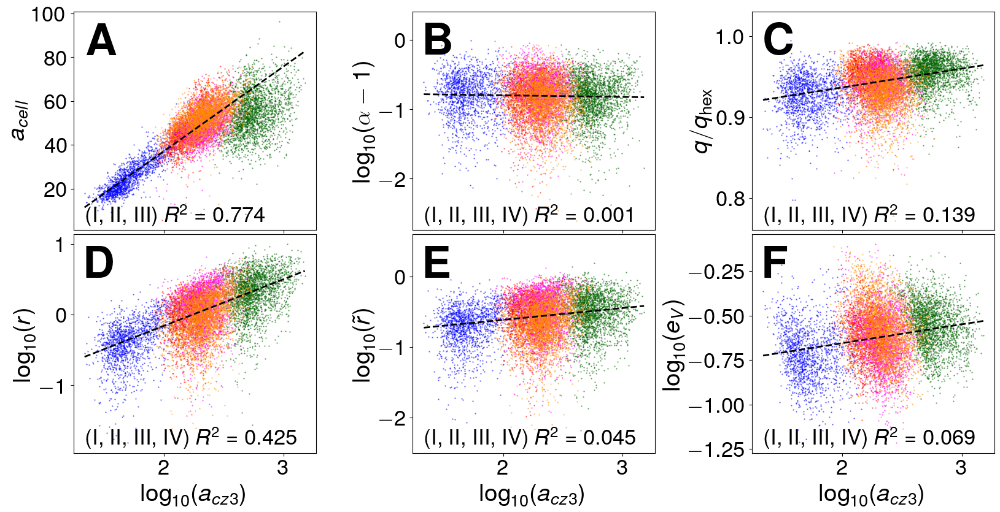

In [21]:
metric_pairs = [
    [('Compartment area', my, 'all') for my in ['Cell area', 'Aspect ratio', 'Circularity']], 
    [('Compartment area', my, 'all') for my in ['Offset', 'Offset (whitened)', 'Voronoi error']],
]
fig, axs = plot_corr(metric_pairs, fmult=1.6)
fig.subplots_adjust(left=0., right=1., bottom=0.05, top=0.95, wspace=0.4, hspace=0.02)
pad_top_ax(axs[str(('Compartment area', 'Aspect ratio', 'all'))])
pad_top_ax(axs[str(('Compartment area', 'Circularity', 'all'))])
pad_top_ax(axs[str(('Compartment area', 'Offset (whitened)', 'all'))])
# save_fig(fig, 'Fig_cam_correlations', exts=['png'])
save_fig(fig, 'PhII_figure9', exts=['pdf'], dpi=100, compressed_dpi=100, jpeg_quality=100)

Processing metric CR / O
Processing regression CR / O
Processing metric CR / O (W)
Processing regression CR / O (W)


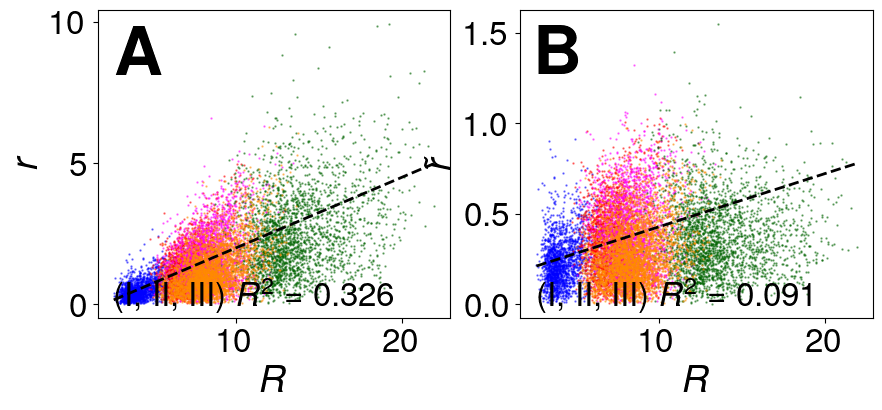

In [34]:
fig, axs = plot_corr([[('Circular radius', 'Offset'), ('Circular radius', 'Offset (whitened)')]], fmult=1.5, apply_corr_transform=False)

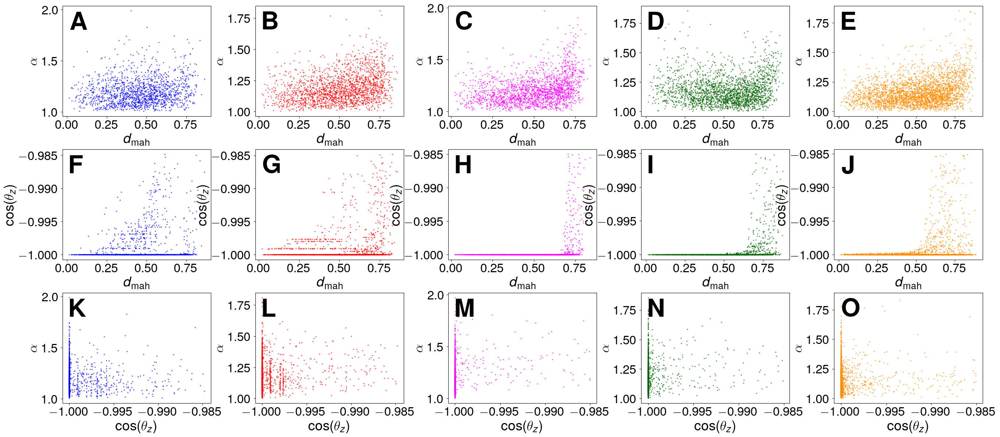

In [22]:
fig, axs = plot_corr([
    # [('Distance to center', 'Aspect ratio', {i}) for i in ['I', 'II', 'III', 'IV', 'S']], 
    [('Mahalanobis distance to center', 'Aspect ratio', {i}) for i in ['I', 'II', 'III', 'IV', 'S']], 
    # [('Distance to center', 'Cell aspect ratio', {i}) for i in ['I', 'II', 'III', 'IV', 'S']],
    # [('Mahalanobis distance to center', 'Cell aspect ratio', {i}) for i in ['I', 'II', 'III', 'IV', 'S']],
    [('Mahalanobis distance to center', 'Chull-projected normal', {i}) for i in ['I', 'II', 'III', 'IV', 'S']],
    # [('Distance to center', 'Chull-projected normal', {i}) for i in ['I', 'II', 'III', 'IV', 'S']],
    [('Chull-projected normal', 'Aspect ratio', {i}) for i in ['I', 'II', 'III', 'IV', 'S']],
], fmult=1.5, apply_corr_transform=False, xlabel_all=True, separate_ap=True, corr=False)
fig.subplots_adjust(left=0., right=1., bottom=0.05, top=0.95, wspace=0.3, hspace=0.3)

ValueError: too many values to unpack (expected 2)

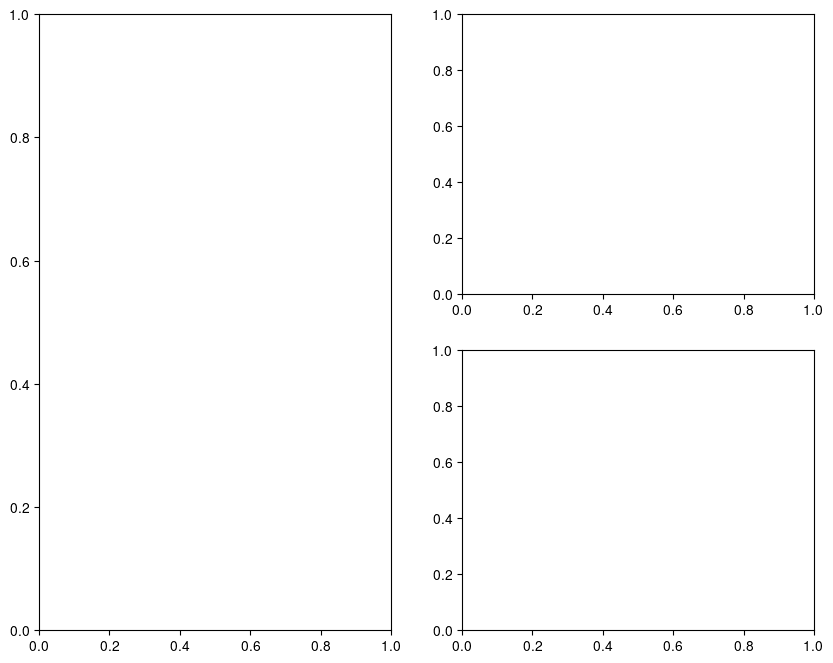

In [31]:
metric_pairs = [('Offset', 'Voronoi error'), ('Offset', 'Circularity')]
fig, axs = plot_corr(metric_pairs, fmult=1.5)
fig.subplots_adjust(left=0., right=1., bottom=0.05, top=0.95, wspace=0.4, hspace=0.)
save_fig(fig, 'Fig_cam_correlations_sup', exts=['png'])

# Fig 6: Schematic

Cell radius (um): 3.4518065694958047
Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure7.uncompressed.pdf


GPL Ghostscript 10.03.0: Can't use Object streams before PDF 1.5, ignoring WriteObjStms directive
GPL Ghostscript 10.03.0: Can't use an XRef stream before PDF 1.5, ignoring WriteXRefStm directive


Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure7.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figure7.pdf


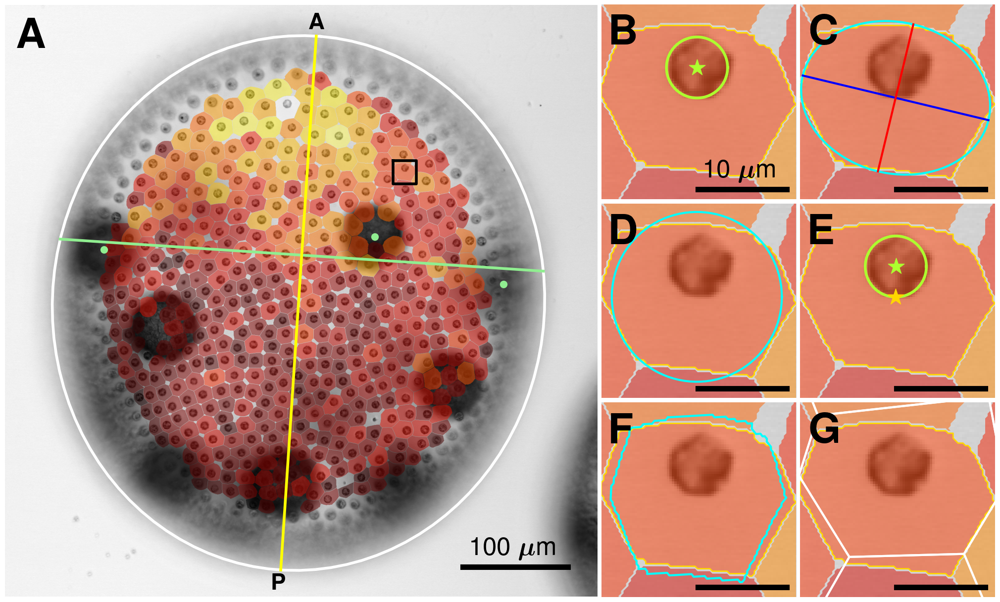

In [103]:
layout = [
    ['z', 'z', 'z', 'a', 'b'],
    ['z', 'z', 'z', 'c', 'd'],
    ['z', 'z', 'z', 'e', 'f'],
]
fig, axs = plt.subplot_mosaic(layout, figsize=(4 * len(layout[0]), 4 * len(layout)))

for k, ax in axs.items():
    ax.set_aspect('equal')
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
        # # Set center of plot to origin
        # xylim = max(np.abs(np.array(ax.get_ylim())).max(), np.abs(np.array(ax.get_xlim())).max())
        # ax.set_ylim(-xylim, xylim)
        # ax.set_xlim(-xylim, xylim)
        # ax.scatter(0, 0, color=scm_mu_c, s=scm_mu_s)

scm_lw = 3
scm_c = 'black'
scm_cm = 'gray'
scm_ls = '--'
scm_mu_c = 'black'
scm_mu_s = 300
scm_mu_m = '*'
scm_x_s = 200
scm_x_m = '*'
cell_color = 'greenyellow'
comp_color = 'gold'
cid_color = 'tomato'
my_scale_fs = int(1.7 * title_fs)
my_label_fs = int(2.8 * title_fs)

disp_group = gsegs.names['III']
disp_seg = gsegs.groups[disp_group][4]
disp_idx = 50 # Pick one so it doesn't keep changing the figure
disp_poly = disp_seg.display_polygons[disp_idx]
disp_cell = Sphere.from_poly(disp_seg.display_cell_polygons[disp_idx])
print(f'Cell radius (um): {disp_seg.cell_polygons[disp_idx].circular_radius()}')
imgx = disp_seg.brightfield.shape[1]

def show_seg(ax, title, show_poly=True):
    disp_metric = disp_seg.metrics['Compartment area']['raw']
    pt.ax_im_gray(ax, disp_seg.brightfield)
    pt.ax_planar_polygons(ax, disp_seg.display_polygons, cmap=lambda _: pt.map_colors(disp_metric, 'continuous'), linewidth=0)
    if show_poly:
        pt.ax_ppoly(ax, disp_poly, alpha=0., linewidth=2, linecolor=comp_color)
    # bbox = ax.get_position()
    # ax.text(0.5, 1 + 0.006 / bbox.height, title, fontsize=int(1.5*title_fs), transform=ax.transAxes, ha='center', va='bottom')

def zoom_poly(ax, sctx=False):
    x0, y0, x1, y1 = disp_poly.bounding_box()
    xm, ym = (x0 + x1) / 2, (y0 + y1) / 2
    dl = max(x1 - x0, y1 - y0)
    ax.set_xlim(xm-dl/2, xm+dl/2)
    ax.set_ylim(ym+dl/2, ym-dl/2)
    pt.ax_scale_bar(ax, 10, upp=disp_seg.upp[0], color='black', units=r'$\bm{\mu}$m', fontsize=my_scale_fs, linewidth=8, label=sctx, text_pad=0.08)

def callout_poly(ax):
    x0, y0, x1, y1 = disp_poly.bounding_box()
    wh = max(x1 - x0, y1 - y0) / 2
    cx, cy = (x0 + x1) / 2, (y0 + y1) / 2
    pt.ax_rect(ax, np.array([cx, cy]), (wh, wh), linewidth=4, color='black')

# Volvox
ax = axs['z']
show_seg(ax, 'trans-PMT + PhII segments', show_poly=False)
disp_seg.plot_ap(ax, linewidth=means_lw*2, mode='diameter', labels=True, fontsize=int(1.5*title_fs))
callout_poly(ax)
pt.label_ax(ax, 0, fontsize=my_label_fs, xy=(0.02, 0.98))
assert np.isclose(disp_seg.upp[0], disp_seg.upp[1]), 'Aymmetric resolution'
crop = 180 # Number of pixels to crop from left & bottom
ax.set_xlim(crop, imgx)
ax.set_ylim(disp_seg.brightfield.shape[0]-crop, 0)
pt.ax_scale_bar(ax, 100, upp=disp_seg.upp[0], color='black', units=r'$\bm{\mu}$m', fontsize=my_scale_fs, linewidth=8, text_pad=0.06)

# Original
ax = axs['a']
show_seg(ax, r'$a_{\rm cz3}, a_{\rm cell}$')
pt.ax_ellipse(ax, disp_cell, color=cell_color, linewidth=4)
# ax.text(disp_cell.v[0], disp_cell.v[1], 'cell', ha='center', va='center', fontsize=title_fs, color='white')
ax.scatter(disp_cell.v[0], disp_cell.v[1], color=cell_color, s=scm_mu_s*2, marker='*', zorder=3)
zoom_poly(ax, sctx=True)
pt.label_ax(ax, 1, fontsize=my_label_fs)
# pt.ax_scale_bar(ax, 10 / disp_seg.upp[0], color='white')

# Aspect ratio
ax = axs['b']
show_seg(ax, r'$\alpha$')
zoom_poly(ax)
pt.label_ax(ax, 2, fontsize=my_label_fs)
poly_ell = Ellipsoid.from_poly(disp_poly)
pt.ax_ellipse(ax, poly_ell, color='cyan', linewidth=scm_lw, axes=True, axes_linewidth=scm_lw)

# Circularity
ax = axs['c']
show_seg(ax, r'$q$')
zoom_poly(ax)
poly_circ = Sphere.from_poly(disp_poly)
pt.ax_ellipse(ax, poly_circ, color='cyan', linewidth=scm_lw)
# ax.text(poly_circ.v[0], poly_circ.v[1], r'$L(\text{compartment})\ge\\L(\text{circle})$', ha='center', va='center', fontsize=title_fs, color='white')
pt.label_ax(ax, 3, fontsize=my_label_fs)

# Offset
ax = axs['d']
show_seg(ax, r'$r$')
zoom_poly(ax)
pt.ax_ellipse(ax, disp_cell, color=cell_color, linewidth=4)
pt.label_ax(ax, 4, fontsize=my_label_fs)
v1, v2 = disp_poly.centroid(), disp_cell.v
ax.scatter(v1[0], v1[1],color=comp_color, s=scm_mu_s*2, marker='*', zorder=3)
ax.scatter(v2[0], v2[1],color=cell_color, s=scm_mu_s*2, marker='*', zorder=3)

# Whitened
ax = axs['e']
show_seg(ax, r'$\tilde{r}$')
zoom_poly(ax)
poly_w, T = disp_poly.whiten(return_W=True)
poly_w = poly_w.match_area(disp_poly.area())
pt.ax_ppoly(ax, poly_w, alpha=0., linewidth=scm_lw, linecolor='cyan')
pt.label_ax(ax, 5, fontsize=my_label_fs)

# Voronoi error
ax = axs['f']
show_seg(ax, r'$e_V$')
pt.ax_planar_polygons(ax, disp_seg.display_vor_polygons, alpha=0., linewidth=scm_lw, linecolor='white')
# ax.scatter(v2[0], v2[1],color=cell_color, s=scm_mu_s, marker='x', zorder=3)
zoom_poly(ax)
pt.label_ax(ax, 6, fontsize=my_label_fs)

fig.subplots_adjust(left=0., right=1., bottom=0.0, top=1., wspace=0.02, hspace=0.02)
# save_fig(fig, 'Fig_cam_metrics', exts=['png'])
save_fig(fig, 'PhII_figure7', exts=['pdf'], dpi=125, compressed_dpi=125, jpeg_quality=85)


### Gamma distributions

In [67]:
def plot_metrics_rvs(metrics: List[Tuple[str, str]], rvs=[stats.gamma], pvalue_statistic='ks', **kwargs):
    fig, axs = plt.subplots(len(metrics), gsegs.n_groups, figsize=(5*gsegs.n_groups, 5*len(metrics)), **kwargs)
    for j, (metric, ap) in enumerate(metrics):
        for i, (_, segs, name, __) in enumerate(gsegs.iterate()):
            vals = []
            ap_pos_metric = metric_metadata[metric]['ap_pos_metric']
            for seg in segs:
                svals = seg.metrics[metric]['nondim'].copy()
                if ap is None:
                    vals.append(svals)
                else:
                    vals.append(svals[seg.get_hemisphere_index(ap, ap_pos_metric)])
            vals = np.concatenate(vals)
            ax = axs[j][i] if len(metrics) > 1 else axs[i]
            if j == 0:
                pt.title_ax(ax, f'Stage {name}')
            if i == 0:
                metric_title = metric if ap is None else f'{metric} ({ap})'
                pt.left_title_ax(ax, metric_title, offset=-0.21)
            rvsargs = dict()
            if not metric_metadata[metric]['floc'] is None:
                rvsargs['loc'] = metric_metadata[metric]['floc']
            pt.plot_hist_rvs(ax, vals, rvs=rvs, bins=50, log=True, pvalues=True, pvalue_statistic=pvalue_statistic, **rvsargs)
            ax.tick_params(axis='x', labelsize=int(ticks_fs))
            ax.tick_params(axis='y', labelsize=int(ticks_fs))
    return fig, axs

/Users/asrvsn/mambaforge/envs/volvox/lib/python3.10/site-packages/matplotlib/scale.py:253: RuntimeWarning: underflow encountered in power
  return np.power(self.base, a)


Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS9.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS9.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS9.pdf


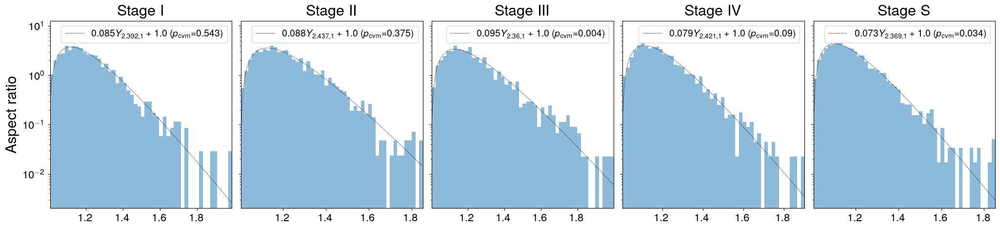

In [68]:
fig, axs = plot_metrics_rvs([('Aspect ratio', None)], sharey='row', pvalue_statistic='cvm')
fig.subplots_adjust(wspace=0.05)
for ax in axs.flatten():
    pad_top_ax(ax, y_frac=0.015)
# save_fig(fig, 'PhII_sup_ar_gamma', exts=['pdf'])
save_fig(fig, 'PhII_figureS9', exts=['pdf'], dpi=150, autorasterize=False)

/Users/asrvsn/mambaforge/envs/volvox/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:178: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/asrvsn/mambaforge/envs/volvox/lib/python3.10/site-packages/matplotlib/scale.py:253: RuntimeWarning: underflow encountered in power
  return np.power(self.base, a)
/Users/asrvsn/mambaforge/envs/volvox/lib/python3.10/site-packages/scipy/stats/_continuous_distns.py:709: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)


Saved uncompressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS8.uncompressed.pdf
Saved compressed figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS8.pdf
Saved figure to /Users/asrvsn/Nextcloud/projects/phii_24/figures/PhII_figureS8.pdf


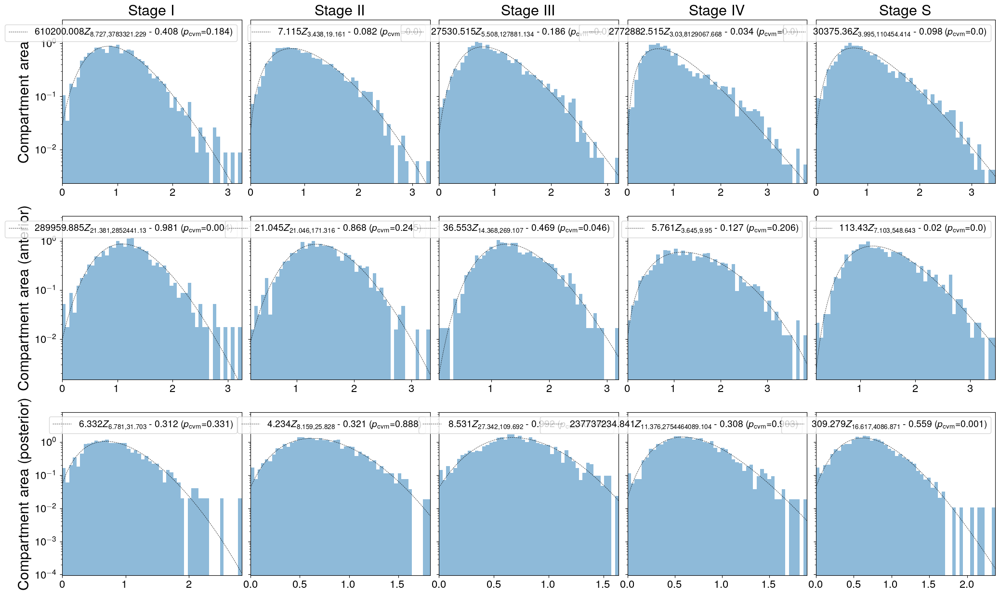

In [69]:
fig, axs = plot_metrics_rvs([('Compartment area', None), ('Compartment area', 'anterior'), ('Compartment area', 'posterior')], rvs=[stats.beta], sharey='row', pvalue_statistic='cvm')
fig.subplots_adjust(wspace=0.05)
for ax in axs.flatten():
    pad_top_ax(ax, y_frac=0.02)
# save_fig(fig, 'PhII_sup_area_gamma', exts=['pdf'])
save_fig(fig, 'PhII_figureS8', exts=['pdf'], dpi=150, autorasterize=False)

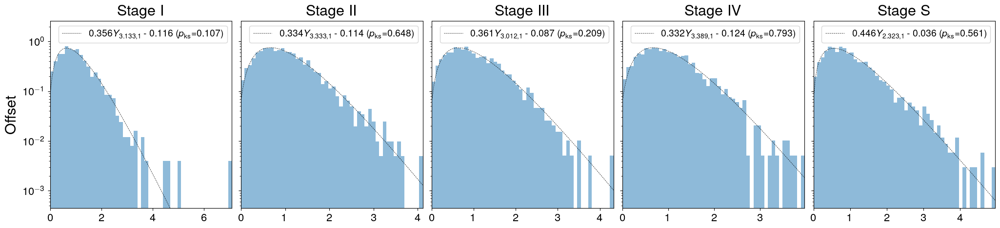

In [43]:
fig, axs = plot_metrics_rvs([('Offset', None)], sharey='row')
fig.subplots_adjust(wspace=0.05)
for ax in axs.flatten():
    pad_top_ax(ax, y_frac=0.02)